# Evolution Divergence

In [ ]:
import matplotlib
import numpy as np
from CM1calc import *
import xarray as xr
import cmocean
import matplotlib.pyplot as plt
import pyart
import gc
import scipy
import matplotlib.patheffects as PathEffects
from scipy.ndimage import gaussian_filter
import dask_image.ndfilters
import dask_image.ndmeasure
import dask.array as da
import matplotlib.patheffects as PathEffects
from matplotlib.offsetbox import AnchoredText
from skimage import measure

%matplotlib inline

dire='resdep125m/'

inputdir='/lustre/research/weiss/schueth/'+dire
output='/home/aschueth/cm1vb19_'+dire

fils=[inputdir+'cm1out_000'+i+'.nc' for i in list(map(str,[241,281,321,361,401,441,481,521,561,601,641,682]))]#only works for 100,999 files
                                                  
Z = [[0,0],[0,0]]
#svort accum
CS3 = plt.contourf(Z,np.linspace(-0.05,0.05,100),cmap=cmocean.cm.balance)
plt.clf()

Z = [[0,0],[0,0]]
#ppert
CS4 = plt.contourf(Z, np.arange(-2.5,0.1,0.25),cmap=cmocean.cm.deep_r)
plt.clf()

Z = [[0,0],[0,0]]
uhlevels = [x for x in [0,15,30,45,60,90,105,120,135,150,165,180,195,210,225,240,255,270,285,300]]
CS5 = plt.contourf(Z, uhlevels,cmap=cmocean.cm.solar)
plt.clf()

fig = plt.figure(figsize=(50,66.667),facecolor='white')

SMALL_SIZE = 40
MEDIUM_SIZE = 60
BIGGER_SIZE = 70

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=MEDIUM_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

ax1=plt.subplot2grid((4,3),(0,0))
ax2=plt.subplot2grid((4,3),(0,1))
ax3=plt.subplot2grid((4,3),(0,2))
ax4=plt.subplot2grid((4,3),(1,0))
ax5=plt.subplot2grid((4,3),(1,1))
ax6=plt.subplot2grid((4,3),(1,2))
ax7=plt.subplot2grid((4,3),(2,0))
ax8=plt.subplot2grid((4,3),(2,1))
ax9=plt.subplot2grid((4,3),(2,2))
ax10=plt.subplot2grid((4,3),(3,0))
ax11=plt.subplot2grid((4,3),(3,1))
ax12=plt.subplot2grid((4,3),(3,2))

ax = [ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8,ax9,ax10,ax11,ax12]
splot = ['a)','b)','c)','d)','e)','f)','g)','h)','i)','j)','k)','l)']

FFCB_bounds=[-2,-3,0,0,-0.5,-2,-3,-3.5,-1,-0.5,-1,-0.2]
FFCB_cons=[-0.5,-0.5,-0.5,-0.25,-0.25,-0.5,-0.25,-0.1,-0.25,-1.5,-1.5,-2]
RFGF_bounds=[-2,-3,0,0,-0.5,-2,-3.2,-3.2,-1,-0.4,-0.9,-0.2]
RFGF_cons=[-1,-0.1,-0.5,-0.5,-0.1,-0.1,-0.1,-0.1,-0.1,-1,-1,-1]
LFCB_cons=[-4,-4,-4,-2,-2,-30,-30,-30,-2,-30,-4,-14]
LFCB_xbounds=[-2,-1,0,-1.5,-3,-3,-3-3,0,0,1,0,0]
LFCB_ybounds=[-3,-3,-2,-2,-2,-2,-2,-2,-3,-2,-0.5,-1.25]
FFCB_label_x=[3.5,2,4,5,6,6,6,6,6,6,5.5,5]
FFCB_label_y=[6,3.5,4,7,7.5,7,7,5.25,4,6.5,6.25,6.25]
RFGF_label_x=[-2,0,1,1,1.5,1,1.5,3,3,3,4,4]
RFGF_label_y=[-7,-7,-8.5,-8.25,-8,-8,-8,-7,-9,-9,-9,-9]
LFCB_label_x=[-9.75,-8.5,-7.25,-8,-8.5,12,12,12,-6,-5,-5,-7.5]
LFCB_label_y=[6,6,6.5,4.5,5,12,12,12,4,6.75,6.5,3.9]

filename = '/lustre/research/weiss/schueth/resdep125m/cm1out_rst_000001.nc'
ds = xr.open_dataset(filename,chunks={'ni':288,'nj':288})
p_base = (ds["prs"][0,:,:,:]/100)

for i,f in enumerate(fils):
    print(i)
    ds = xr.open_dataset(fils[i],chunks={'ni':288,'nj':288})

    time = (ds['time']/np.timedelta64(1, 's'))
    x = ds['xh']
    y = ds['yh']
    z = ds['z']
    w = ds['winterp'].isel(time=0)
    zvort = ds['zvort'].isel(time=0)

    UH=np.sum((w*zvort).isel(nk=slice(find_nearest(z,2),find_nearest(z,6))),axis=0)
    #for a 5 km gaussian kernel, sigma=40 with a 125 m gird spacing
    filtered_UH=gaussian_filter(UH,sigma=40)
    cy,cx = np.unravel_index(np.argmax(filtered_UH),np.shape(filtered_UH))

    x=x-x[cx]
    y=y-y[cy]
    X,Y=np.meshgrid(x,y)
    dxx=dx(x)

    ref =ds['dbz'].isel(time=0,nk=0)
    u = ds['uinterp'].isel(time=0)
    v = ds['vinterp'].isel(time=0)
    w = ds['winterp'].isel(time=0)
    xvort =ds['xvort'].isel(time=0)
    yvort =ds['yvort'].isel(time=0)
    zvort =ds['zvort'].isel(time=0)
    ppert = ds['prspert'].isel(time=0)/100.
    th = ds['th'].isel(time=0,nk=0)
    qr = ds['qr'].isel(time=0,nk=0)
    qi = ds['qi'].isel(time=0,nk=0)
    qc = ds['qc'].isel(time=0,nk=0)
    qs = ds['qs'].isel(time=0,nk=0)
    qg = ds['qg'].isel(time=0,nk=0)
    qv = ds['qv'].isel(time=0,nk=0)

    trhopert=perturbation(trho(th,qv,qi,qc,qs,qr,qg),trho(th,qv,qi,qc,qs,qr,qg)[0,-1])

    te=thetae(qv, th, p_base[0,:,:])
    tep = perturbation(te,te[0,-1])

    wind = np.sqrt(u**2+v**2+w**2)
    svort=(u*xvort+v*yvort+w*zvort)/wind
    svorth=(u*xvort+v*yvort)/np.sqrt(u**2+v**2)

    dudx,dudy,dudz,dvdx,dvdy,dvdz,dwdx,dwdy,dwdz = vector_gradient_components(u,v,w,dxx*1000,np.gradient(z)*1000)
    divergence = dudx+dvdy#+dwdz

    skip= (slice(None, None, int(1.25/dxx)), slice(None, None, int(1.25/dxx)))

    tr=ax[i].contourf(X,Y,divergence[5,:,:],np.linspace(-0.05,0.05,100),cmap=cmocean.cm.balance,extend='both')#,alpha=0.85, antialiased=True)

    ax[i].contour(X[find_nearest(y,FFCB_bounds[i]):,:],Y[find_nearest(y,FFCB_bounds[i]):,:],trhopert[find_nearest(y,FFCB_bounds[i]):,:],[FFCB_cons[i]],colors='k',alpha=0.4,linewidths=15)#,alpha=0.85, antialiased=True)
    RFGF_mask = np.zeros_like(trhopert)
    for j in range(find_nearest(y,-11),find_nearest(y,11)):
        RFGF_mask[j,np.where(trhopert[j,:]<RFGF_cons[i])[0][-1]:]=1
    ax[i].contour(X[:find_nearest(y,RFGF_bounds[i]),:],Y[:find_nearest(y,RFGF_bounds[i]),:],gaussian_filter(RFGF_mask[:find_nearest(y,RFGF_bounds[i]),:],sigma=1),[0.5],colors='k',alpha=0.4,linewidths=15,linestyles='solid')#,alpha=0.85, antialiased=True)

    if i in [0,1,2,8,11]:
        LFCB_mask = np.zeros_like(tep)
        for j in range(find_nearest(y,-11),find_nearest(y,11)):
            LFCB_mask[j,np.where(tep[j,:]<LFCB_cons[i])[0][-1]:]=1
        contours = measure.find_contours(gaussian_filter(LFCB_mask[find_nearest(y,LFCB_ybounds[i]):,:find_nearest(x,LFCB_xbounds[i])],sigma=1), 0.5)
        ax[i].scatter(x[:find_nearest(x,LFCB_xbounds[i])][list(contours[0][::15,1].astype(int))].values,y[find_nearest(y,LFCB_ybounds[i]):][list(contours[0][::15,0].astype(int))].values,s=700,c='k',alpha=0.4)
    elif i in [9,10]:
        LFCB_mask = np.zeros_like(tep)
        for j in range(find_nearest(y,-11),find_nearest(y,11)):
            try:
                LFCB_mask[j,np.where(trhopert[j,:]<-4.75)[0][-1]:]=1
            except: pass
        contours = measure.find_contours(gaussian_filter(LFCB_mask[find_nearest(y,LFCB_ybounds[i]):find_nearest(y,9),:find_nearest(x,LFCB_xbounds[i])],sigma=1), 0.5)
        ax[i].scatter(x[:find_nearest(x,LFCB_xbounds[i])][list(contours[0][::15,1].astype(int))].values,y[find_nearest(y,LFCB_ybounds[i]):][list(contours[0][::15,0].astype(int))].values,s=700,c='k',alpha=0.4)
    else:
        try:
            contours = measure.find_contours(tep[find_nearest(y,LFCB_ybounds[i]):,:find_nearest(x,LFCB_xbounds[i])], LFCB_cons[i])
            ax[i].scatter(x[:find_nearest(x,LFCB_xbounds[i])][list(contours[0][::15,1].astype(int))].values,y[find_nearest(y,LFCB_ybounds[i]):][list(contours[0][::15,0].astype(int))].values,s=700,c='k',alpha=0.4)
        except: pass
    if i in [9]:
        LFCB_mask = np.zeros_like(tep)
        for j in range(find_nearest(y,-11),find_nearest(y,11)):
            try:
                LFCB_mask[j,np.where(tep[j,:]<-6)[0][-1]:]=1
            except: LFCB_mask[j,0]=1
        contours = measure.find_contours(gaussian_filter(LFCB_mask[find_nearest(y,0):find_nearest(y,9),find_nearest(x,-5):find_nearest(x,2)],sigma=1), 0.5)
        ax[i].scatter(x[find_nearest(x,-5):find_nearest(x,2)][list(contours[0][::15,1].astype(int))].values,y[find_nearest(y,0):find_nearest(y,9)][list(contours[0][::15,0].astype(int))].values,s=700,c='k',alpha=0.4)
    if i in [10]:
        LFCB_mask = np.zeros_like(tep)
        for j in range(find_nearest(y,-11),find_nearest(y,11)):
            try:
                LFCB_mask[j,np.where(trhopert[j,:]<-4)[0][-1]:]=1
            except: LFCB_mask[j,0]=1
        contours = measure.find_contours(gaussian_filter(LFCB_mask[find_nearest(y,-1.5):find_nearest(y,9),find_nearest(x,-5):find_nearest(x,2)],sigma=1), 0.5)
        ax[i].scatter(x[find_nearest(x,-5):find_nearest(x,2)][list(contours[0][::15,1].astype(int))].values,y[find_nearest(y,-1.5):find_nearest(y,9)][list(contours[0][::15,0].astype(int))].values,s=700,c='k',alpha=0.4)
    if i in [11]:
        LFCB_mask = np.zeros_like(tep)
        for j in range(find_nearest(y,-11),find_nearest(y,11)):
            try:
                LFCB_mask[j,np.where(tep[j,:]<-8)[0][-1]:]=1
            except: LFCB_mask[j,0]=1
        contours = measure.find_contours(gaussian_filter(LFCB_mask[find_nearest(y,0):find_nearest(y,9),find_nearest(x,-5):find_nearest(x,2)],sigma=1), 0.5)
        ax[i].scatter(x[find_nearest(x,-5):find_nearest(x,2)][list(contours[0][::15,1].astype(int))].values,y[find_nearest(y,0):find_nearest(y,9)][list(contours[0][::15,0].astype(int))].values,s=700,c='k',alpha=0.4)

    db=ax[i].contour(X, Y, ref, [40], colors='black',linewidths=3,linestyles='dashed')
#     CS_ppert=ax[i].contour(X,Y,ppert[find_nearest(z,0.5),:,:],np.arange(-2.5,0.1,0.25),colors='k',linewidths=6,linestyles='solid')
#     CS_ppert=ax[i].contour(X,Y,ppert[find_nearest(z,0.5),:,:],np.arange(-2.5,0.1,0.25),cmap=cmocean.cm.deep_r,linewidths=5)
#     ax[i].clabel(CS_ppert, np.arange(-2.5,0.1,0.25), inline=True, fontsize=30)
#     ax[i].contour(X,Y,ppert[find_nearest(z,0.5),:,:],np.arange(-20,-2.5,0.25),colors=matplotlib.colors.to_hex(cmocean.cm.deep_r(0)),linewidths=1.5)

    #     uh=ax[i].contour(X,Y,gaussian_filter(UH,sigma=1),[15,30,45,60,90,105,120,135,150,165,180,195,210,225,240,255,270,285,300],cmap=cmocean.cm.solar,linewidth=10)

    t1=ax[i].text(0.99, 0.99, 'Time = '+str(int(time[0].values))+' s', verticalalignment='top', horizontalalignment='right',transform=ax[i].transAxes, fontsize=65)
    t1.set_path_effects([PathEffects.withStroke(linewidth=5,foreground='white')])
    t2=ax[i].text(0.025, 0.975, splot[i], verticalalignment='top', horizontalalignment='left',transform=ax[i].transAxes, fontsize=125)
    t2.set_path_effects([PathEffects.withStroke(linewidth=10,foreground='white')])
    
    ax[i].set_xlim(-10,10)
    ax[i].set_ylim(-10,10)

    if i%3 == 0:
        ax[i].set_yticks(np.arange(-9,10,3))
        ax[i].set_ylabel('Kilometers')
    else:
        ax[i].set_yticklabels('')
    if int(i/3) == 3:
        ax[i].set_xticks(np.arange(-9,10,3))
        ax[i].set_xlabel('Kilometers')

    else:
        ax[i].set_xticklabels('')
        
    ax[i].text(FFCB_label_x[i], FFCB_label_y[i], 'FFCB', verticalalignment='center', horizontalalignment='left',c='k', fontsize=85,alpha=0.4)
    ax[i].text(RFGF_label_x[i], RFGF_label_y[i], 'RFGF', verticalalignment='center', horizontalalignment='left',c='k', fontsize=85,alpha=0.4)
    if i in [0,1,2,3,4,8]:
        ax[i].text(LFCB_label_x[i], LFCB_label_y[i], 'LFCB', verticalalignment='center', horizontalalignment='left',c='k', fontsize=85,alpha=0.4)
    if i in [9,10,11]:
        ax[i].text(LFCB_label_x[i], LFCB_label_y[i], 'LFCBs', verticalalignment='center', horizontalalignment='left',c='k', fontsize=85,alpha=0.4)

cbar_ax = plt.axes([1.0, 0.0275, 0.035, 0.9625])
cbar=plt.colorbar(CS3, cax=cbar_ax, ticks=np.linspace(-0.05,0.05,11))
cbar.set_label(r'Divergence [s$^{-1}$]')# 137.5 m AGL

# cbar_ax = plt.axes([0.05, -0.02 ,0.46, 0.015])
# cbar=plt.colorbar(CS4, cax=cbar_ax, ticks=np.arange(-2.5,0.1,0.25), orientation='horizontal')
# cbar.set_label('Pressure Perurbation [hPa]')

# cbar_ax = plt.axes([0.33, -0.03 ,0.25, 0.015])
# cbar=plt.colorbar(CS5, cax=cbar_ax, ticks=[0,60,120,180,240,300], orientation='horizontal')
# cbar.set_label('2-5 km Updraft Helicity '+r'$[m^2$ '+r'$s^{-2}$]')


patch = matplotlib.patches.Ellipse((0.75,-0.015), 0.04,0.03,linestyle='--',linewidth=5,color='k',fill=False,transform=fig.transFigure,zorder=1000)
ax = fig.add_axes([-0.1,-0.1,1,1],facecolor=None)
ax.xaxis.set_visible(False)
ax.yaxis.set_visible(False)
ax.set_zorder(1000)
ax.add_patch(patch)
ax.patch.set_alpha(0)
ax.axis("off")
ax.text(0.85,-0.012, '40 dBZ', verticalalignment='top', horizontalalignment='right',transform=fig.transFigure, fontsize=65)
plt.subplots_adjust(wspace=0.01,hspace=0.01)
plt.tight_layout()

plt.subplots_adjust(wspace=0.01,hspace=0.01)
plt.tight_layout()


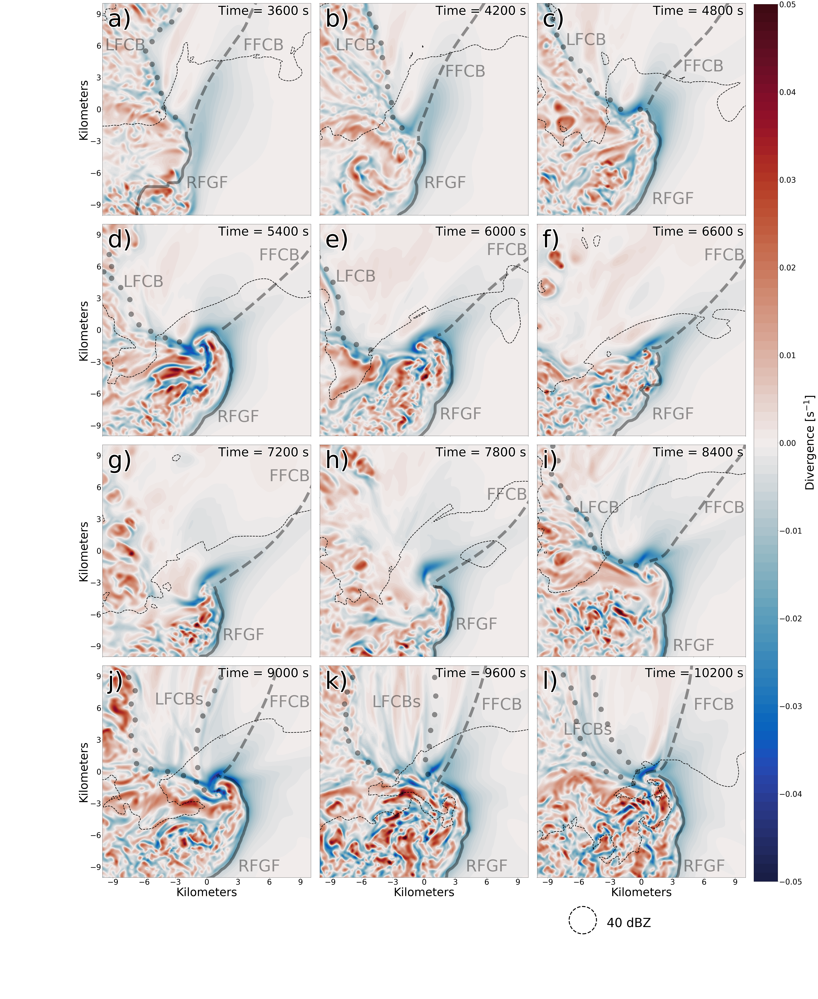

# Evolution w

In [ ]:
import matplotlib
import numpy as np
from CM1calc import *
import xarray as xr
import cmocean
import matplotlib.pyplot as plt
import pyart
import gc
import scipy
import matplotlib.patheffects as PathEffects
from scipy.ndimage import gaussian_filter
import dask_image.ndfilters
import dask_image.ndmeasure
import dask.array as da
import matplotlib.patheffects as PathEffects
from matplotlib.offsetbox import AnchoredText
from skimage import measure

%matplotlib inline

def UHcenter(x,z,w,zvort):
    '''
    Function finds the centroid of the gaussian smoothed 2-5 km UH, if fields are zero, return middle of domain

    Paramters: x (array), z (array), w (array), zvort (array)
    Returns: indices of centroid (y,x)

    Example: x0, y0 = CM1calc.UHcenter(x,z,w,zvort)
    '''
    
    gausfactor=np.around((1./dx(x))/0.16)
    UH = (w[0,find_nearest(z,2):find_nearest(z,5),:,:]*zvort[0,find_nearest(z,2):find_nearest(z,5),:,:])
    UH=UH.data
    UH = UH.sum(axis=0)

    gauss = dask_image.ndfilters.gaussian_filter(UH,sigma=10)
    UHfil=gauss>(0.75*np.amax(gauss))
    
    labelsmaxUH,numlabelsmaxUH=dask_image.ndmeasure.label(UHfil)
    biggest=label_count(labelsmaxUH,numlabelsmaxUH,UHfil)
    mask=np.zeros_like(labelsmaxUH)
    try:
        mask[labelsmaxUH==biggest[0][0]]=1
        centroidsUH=dask_image.ndmeasure.center_of_mass(mask)
    except:
        print('UH not found')
        centroidsUH=(np.shape(UH)[0]/2,np.shape(UH)[0]/2)
    return centroidsUH


dire='resdep125m/'

inputdir='/lustre/research/weiss/schueth/'+dire
output='/home/aschueth/cm1vb19_'+dire

fils=[inputdir+'cm1out_000'+i+'.nc' for i in list(map(str,[241,281,321,361,401,441,481,521,561,601,641,682]))]#only works for 100,999 files
                                                  
Z = [[0,0],[0,0]]
trholevels = [x / 100. for x in range(-900, 1, 1)]
CS3 = plt.contourf(Z, np.arange(-10,10.1,0.1), cmap=cmocean.cm.balance)
plt.clf()

Z = [[0,0],[0,0]]
CS4 = plt.contourf(Z, np.arange(0.005,0.155,0.005),cmap=cmocean.cm.thermal)
plt.clf()

Z = [[0,0],[0,0]]
uhlevels = [x for x in [0,15,30,45,60,90,105,120,135,150,165,180,195,210,225,240,255,270,285,300]]
CS5 = plt.contourf(Z, uhlevels,cmap=cmocean.cm.solar)
plt.clf()

fig = plt.figure(figsize=(50,66.667),facecolor='white')

SMALL_SIZE = 40
MEDIUM_SIZE = 60
BIGGER_SIZE = 70

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=MEDIUM_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

ax1=plt.subplot2grid((4,3),(0,0))
ax2=plt.subplot2grid((4,3),(0,1))
ax3=plt.subplot2grid((4,3),(0,2))
ax4=plt.subplot2grid((4,3),(1,0))
ax5=plt.subplot2grid((4,3),(1,1))
ax6=plt.subplot2grid((4,3),(1,2))
ax7=plt.subplot2grid((4,3),(2,0))
ax8=plt.subplot2grid((4,3),(2,1))
ax9=plt.subplot2grid((4,3),(2,2))
ax10=plt.subplot2grid((4,3),(3,0))
ax11=plt.subplot2grid((4,3),(3,1))
ax12=plt.subplot2grid((4,3),(3,2))

ax = [ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8,ax9,ax10,ax11,ax12]
splot = ['a)','b)','c)','d)','e)','f)','g)','h)','i)','j)','k)','l)']

FFCB_bounds=[-2,-3,0,0,-0.5,-2,-3,-3.5,-1,-0.5,-1,-0.2]
FFCB_cons=[-0.5,-0.5,-0.5,-0.25,-0.25,-0.5,-0.25,-0.1,-0.25,-1.5,-1.5,-2]
RFGF_bounds=[-2,-3,0,0,-0.5,-2,-3.2,-3.2,-1,-0.4,-0.9,-0.2]
RFGF_cons=[-1,-0.1,-0.5,-0.5,-0.1,-0.1,-0.1,-0.1,-0.1,-1,-1,-1]
LFCB_cons=[-4,-4,-4,-2,-2,-30,-30,-30,-2,-30,-4,-14]
LFCB_xbounds=[-2,-1,0,-1.5,-3,-3,-3-3,0,0,1,0,0]
LFCB_ybounds=[-3,-3,-2,-2,-2,-2,-2,-2,-3,-2,-0.5,-1.25]
FFCB_label_x=[3.5,2,4,5,6,6,6,6,6,6,5.5,5]
FFCB_label_y=[6,3.5,4,7,7.5,7,7,5.25,4,6.5,6.25,6.25]
RFGF_label_x=[-2,0,1,1,1.5,1,1.5,3,3,3,4,4]
RFGF_label_y=[-7,-7,-8.5,-8.25,-8,-8,-8,-7,-9,-9,-9,-9]
LFCB_label_x=[-9.75,-8.5,-7.25,-8,-8.5,12,12,12,-6,-5,-5,-7.5]
LFCB_label_y=[6,6,6.5,4.5,5,12,12,12,4,6.75,6.5,3.9]

filename = '/lustre/research/weiss/schueth/resdep125m/cm1out_rst_000001.nc'
ds = xr.open_dataset(filename,chunks={'ni':288,'nj':288})
p_base = (ds["prs"][0,:,:,:]/100)

for i,f in enumerate(fils):
    print(i)
    ds = xr.open_dataset(fils[i],chunks={'ni':288,'nj':288})

    time = (ds['time']/np.timedelta64(1, 's'))
    x = ds['xh']
    y = ds['yh']
    z = ds['z']
    w = ds['winterp'].isel(time=0)
    zvort = ds['zvort'].isel(time=0)
    
    UH=np.sum((w*zvort).isel(nk=slice(find_nearest(z,2),find_nearest(z,6))),axis=0)
    #for a 5 km gaussian kernel, sigma=40 with a 125 m gird spacing
    filtered_UH=gaussian_filter(UH,sigma=40)
    cy,cx = np.unravel_index(np.argmax(filtered_UH),np.shape(filtered_UH))

    x=x-x[cx]
    y=y-y[cy]
    X,Y=np.meshgrid(x,y)

    dxx=dx(x)

    ref =ds['dbz'].isel(time=0,nk=0)
    u = ds['uinterp'].isel(time=0)
    v = ds['vinterp'].isel(time=0)
    w = ds['winterp'].isel(time=0)
    xvort =ds['xvort'].isel(time=0)
    yvort =ds['yvort'].isel(time=0)
    zvort =ds['zvort'].isel(time=0)
    ppert = ds['prspert'].isel(time=0,nk=0)/100.
    th = ds['th'].isel(time=0,nk=0)
    qr = ds['qr'].isel(time=0,nk=0)
    qi = ds['qi'].isel(time=0,nk=0)
    qc = ds['qc'].isel(time=0,nk=0)
    qs = ds['qs'].isel(time=0,nk=0)
    qg = ds['qg'].isel(time=0,nk=0)
    qv = ds['qv'].isel(time=0,nk=0)

    trhopert=perturbation(trho(th,qv,qi,qc,qs,qr,qg),trho(th,qv,qi,qc,qs,qr,qg)[0,-1])

    te=thetae(qv, th, p_base[0,:,:])
    tep = perturbation(te,te[0,-1])

    wind = np.sqrt(u**2+v**2+w**2)
    svort=(u*xvort+v*yvort+w*zvort)/wind
    svorth=(u*xvort+v*yvort)/np.sqrt(u**2+v**2)

    tr=ax[i].contourf(X,Y,w[find_nearest(z,0.5),:,:],np.arange(-10,10.1,0.1),cmap=cmocean.cm.balance,extend='both')#,alpha=0.85, antialiased=True)
    
    ax[i].contour(X[find_nearest(y,FFCB_bounds[i]):,:],Y[find_nearest(y,FFCB_bounds[i]):,:],trhopert[find_nearest(y,FFCB_bounds[i]):,:],[FFCB_cons[i]],colors='k',alpha=0.4,linewidths=15)#,alpha=0.85, antialiased=True)
    RFGF_mask = np.zeros_like(trhopert)
    for j in range(find_nearest(y,-11),find_nearest(y,11)):
        RFGF_mask[j,np.where(trhopert[j,:]<RFGF_cons[i])[0][-1]:]=1
    ax[i].contour(X[:find_nearest(y,RFGF_bounds[i]),:],Y[:find_nearest(y,RFGF_bounds[i]),:],gaussian_filter(RFGF_mask[:find_nearest(y,RFGF_bounds[i]),:],sigma=1),[0.5],colors='k',alpha=0.4,linewidths=15,linestyles='solid')#,alpha=0.85, antialiased=True)

    if i in [0,1,2,8,11]:
        LFCB_mask = np.zeros_like(tep)
        for j in range(find_nearest(y,-11),find_nearest(y,11)):
            LFCB_mask[j,np.where(tep[j,:]<LFCB_cons[i])[0][-1]:]=1
        contours = measure.find_contours(gaussian_filter(LFCB_mask[find_nearest(y,LFCB_ybounds[i]):,:find_nearest(x,LFCB_xbounds[i])],sigma=1), 0.5)
        ax[i].scatter(x[:find_nearest(x,LFCB_xbounds[i])][list(contours[0][::15,1].astype(int))].values,y[find_nearest(y,LFCB_ybounds[i]):][list(contours[0][::15,0].astype(int))].values,s=700,c='k',alpha=0.4)
    elif i in [9,10]:
        LFCB_mask = np.zeros_like(tep)
        for j in range(find_nearest(y,-11),find_nearest(y,11)):
            try:
                LFCB_mask[j,np.where(trhopert[j,:]<-4.75)[0][-1]:]=1
            except: pass
        contours = measure.find_contours(gaussian_filter(LFCB_mask[find_nearest(y,LFCB_ybounds[i]):find_nearest(y,9),:find_nearest(x,LFCB_xbounds[i])],sigma=1), 0.5)
        ax[i].scatter(x[:find_nearest(x,LFCB_xbounds[i])][list(contours[0][::15,1].astype(int))].values,y[find_nearest(y,LFCB_ybounds[i]):][list(contours[0][::15,0].astype(int))].values,s=700,c='k',alpha=0.4)
    else:
        try:
            contours = measure.find_contours(tep[find_nearest(y,LFCB_ybounds[i]):,:find_nearest(x,LFCB_xbounds[i])], LFCB_cons[i])
            ax[i].scatter(x[:find_nearest(x,LFCB_xbounds[i])][list(contours[0][::15,1].astype(int))].values,y[find_nearest(y,LFCB_ybounds[i]):][list(contours[0][::15,0].astype(int))].values,s=700,c='k',alpha=0.4)
        except: pass
    if i in [9]:
        LFCB_mask = np.zeros_like(tep)
        for j in range(find_nearest(y,-11),find_nearest(y,11)):
            try:
                LFCB_mask[j,np.where(tep[j,:]<-6)[0][-1]:]=1
            except: LFCB_mask[j,0]=1
        contours = measure.find_contours(gaussian_filter(LFCB_mask[find_nearest(y,0):find_nearest(y,9),find_nearest(x,-5):find_nearest(x,2)],sigma=1), 0.5)
        ax[i].scatter(x[find_nearest(x,-5):find_nearest(x,2)][list(contours[0][::15,1].astype(int))].values,y[find_nearest(y,0):find_nearest(y,9)][list(contours[0][::15,0].astype(int))].values,s=700,c='k',alpha=0.4)
    if i in [10]:
        LFCB_mask = np.zeros_like(tep)
        for j in range(find_nearest(y,-11),find_nearest(y,11)):
            try:
                LFCB_mask[j,np.where(trhopert[j,:]<-4)[0][-1]:]=1
            except: LFCB_mask[j,0]=1
        contours = measure.find_contours(gaussian_filter(LFCB_mask[find_nearest(y,-1.5):find_nearest(y,9),find_nearest(x,-5):find_nearest(x,2)],sigma=1), 0.5)
        ax[i].scatter(x[find_nearest(x,-5):find_nearest(x,2)][list(contours[0][::15,1].astype(int))].values,y[find_nearest(y,-1.5):find_nearest(y,9)][list(contours[0][::15,0].astype(int))].values,s=700,c='k',alpha=0.4)
    if i in [11]:
        LFCB_mask = np.zeros_like(tep)
        for j in range(find_nearest(y,-11),find_nearest(y,11)):
            try:
                LFCB_mask[j,np.where(tep[j,:]<-8)[0][-1]:]=1
            except: LFCB_mask[j,0]=1
        contours = measure.find_contours(gaussian_filter(LFCB_mask[find_nearest(y,0):find_nearest(y,9),find_nearest(x,-5):find_nearest(x,2)],sigma=1), 0.5)
        ax[i].scatter(x[find_nearest(x,-5):find_nearest(x,2)][list(contours[0][::15,1].astype(int))].values,y[find_nearest(y,0):find_nearest(y,9)][list(contours[0][::15,0].astype(int))].values,s=700,c='k',alpha=0.4)

        
    db=ax[i].contour(X, Y, ref, [40], colors='black',linewidths=3,linestyles='dashed')

    t1=ax[i].text(0.99, 0.99, 'Time = '+str(int(time[0].values))+' s', verticalalignment='top', horizontalalignment='right',transform=ax[i].transAxes, fontsize=65)
    t1.set_path_effects([PathEffects.withStroke(linewidth=5,foreground='white')])
    t2=ax[i].text(0.025, 0.975, splot[i], verticalalignment='top', horizontalalignment='left',transform=ax[i].transAxes, fontsize=125)
    t2.set_path_effects([PathEffects.withStroke(linewidth=10,foreground='white')])
    
    ax[i].set_xlim(-10,10)
    ax[i].set_ylim(-10,10)

    if i%3 == 0:
        ax[i].set_yticks(np.arange(-9,10,3))
        ax[i].set_ylabel('Kilometers')
    else:
        ax[i].set_yticklabels('')
    if int(i/3) == 3:
        ax[i].set_xticks(np.arange(-9,10,3))
        ax[i].set_xlabel('Kilometers')

    else:
        ax[i].set_xticklabels('')

    ax[i].text(FFCB_label_x[i], FFCB_label_y[i], 'FFCB', verticalalignment='center', horizontalalignment='left',c='k', fontsize=85,alpha=0.4)
    ax[i].text(RFGF_label_x[i], RFGF_label_y[i], 'RFGF', verticalalignment='center', horizontalalignment='left',c='k', fontsize=85,alpha=0.4)
    if i in [0,1,2,3,4,8]:
        ax[i].text(LFCB_label_x[i], LFCB_label_y[i], 'LFCB', verticalalignment='center', horizontalalignment='left',c='k', fontsize=85,alpha=0.4)
    if i in [9,10,11]:
        ax[i].text(LFCB_label_x[i], LFCB_label_y[i], 'LFCBs', verticalalignment='center', horizontalalignment='left',c='k', fontsize=85,alpha=0.4)

cbar_ax = plt.axes([1.0, 0.0275, 0.035, 0.9625])
cbar=plt.colorbar(CS3, cax=cbar_ax, ticks=[-10,-8,-6,-4,-2,0,2,4,6,8,10])
cbar.set_label('Vertical Velocity [m s$^{-1}$]')

patch = matplotlib.patches.Ellipse((0.75,-0.015), 0.04,0.03,linestyle='--',linewidth=5,color='k',fill=False,transform=fig.transFigure,zorder=1000)
ax = fig.add_axes([-0.1,-0.1,1,1],facecolor=None)
ax.xaxis.set_visible(False)
ax.yaxis.set_visible(False)
ax.set_zorder(1000)
ax.add_patch(patch)
ax.patch.set_alpha(0)
ax.axis("off")
ax.text(0.85,-0.012, '40 dBZ', verticalalignment='top', horizontalalignment='right',transform=fig.transFigure, fontsize=65)
plt.subplots_adjust(wspace=0.01,hspace=0.01)
plt.tight_layout()

plt.subplots_adjust(wspace=0.01,hspace=0.01)
plt.tight_layout()


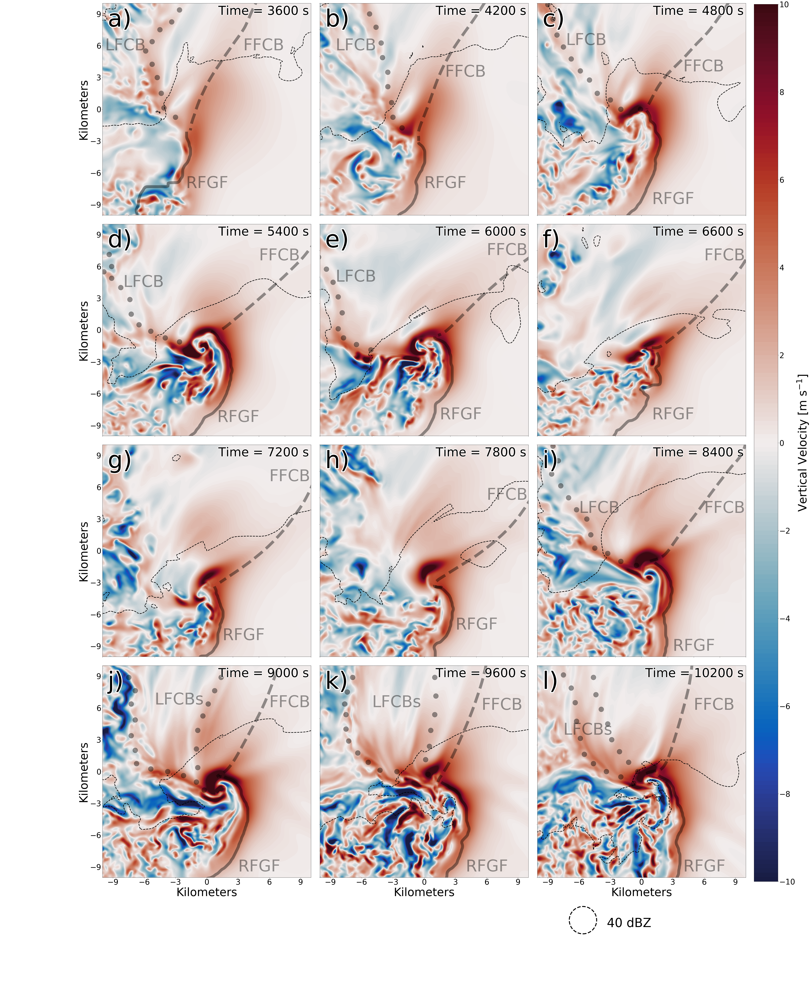

# RHI PGF and Stretching

In [ ]:
import matplotlib
matplotlib.use('agg')
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.colors import LinearSegmentedColormap
from scipy.interpolate import interp1d
from datetime import datetime
from matplotlib.colors import Normalize
import numpy.ma as ma
import matplotlib.colors as colors
from scipy.ndimage import gaussian_filter
import cmocean
import operator
import gc
import xarray as xr
from xarray.backends import NetCDF4DataStore
from scipy.ndimage import map_coordinates
import matplotlib.patheffects as PathEffects
from CM1calc import *
import dask
import dask_image.ndfilters
import dask_image.ndmeasure
import dask.array as da
from metpy import constants as mpconsts
from skimage.measure import label
from skimage.morphology import erosion, dilation, opening, closing, disk
import scipy
%matplotlib inline

def RHIvort(vel,phi):
    '''
    Function calculates the vorticity on an RHI assuming solid body rotation. Vorticity vector is also assumed normal to plane.
    Calculation: (1/r)*(du_r/dphi), taken from wolfram mathworld on spherical vorticity calculations. 
    Originally was negative, but due to polar coordiantes being reversed in radar world, it is actually positive.
    
    Parameter: radar (pyart object), swp_id (int)
    Returns: vorticity array, same shape as velocity array
    
    For loop iterates through all radii and all slices, the expanded version would look like this:
        
    #radius = 4
    every40 = slice(0, None, 4)
    every41 = slice(1, None, 4)
    every42 = slice(2, None, 4)
    every43 = slice(3, None, 4)
    
    vort4 = np.zeros_like(vel)
    vort4[every40,:] = (1/rangearray[every40,:])*np.gradient(vel[every40,:],phi[every40],axis=0)
    vort4[every41,:] = (1/rangearray[every41,:])*np.gradient(vel[every41,:],phi[every41],axis=0)
    vort4[every42,:] = (1/rangearray[every42,:])*np.gradient(vel[every42,:],phi[every42],axis=0)
    vort4[every43,:] = (1/rangearray[every43,:])*np.gradient(vel[every43,:],phi[every43],axis=0)

    '''
    rangearray=np.linspace(0,RHIlength*1000,bins)
    vort = np.zeros_like(vel)
    vort=(1/rangearray)*np.gradient(vel,np.deg2rad(phi),axis=0) 
        
    return vort

@jit
def variant(array,delta):
    '''
    Function finds local variance at a point. The mean in a floating window of size i-delta to i+delta
    is subtracted from the value at the point i, to calculate the local variance. A larger window will blur the variance more.

    Parameters: array (array), delta (int)
    Returns: variance (array, not the same size I don't think)

    This function is optimized by jit
    '''

    var=np.zeros_like(array)
    d=len(np.shape(array))

    for i in range(np.shape(array)[-1]):
        for j in range(np.shape(array)[-2]):
            if d == 3:
                for k in range(np.shape(array)[-3]):
                    var[k,j,i]=abs(array[k,j,i]-np.nanmean(array[k,j-delta:j+delta,i-delta:i+delta]))
                return(var)
            elif d == 2:
                var[i,j]=abs(array[i,j]-np.nanmean(array[i-delta:i+delta,j-delta:j+delta]))
                return(var)
            
def UHcenter(x,z,w,zvort):
    '''
    Function finds the centroid of the gaussian smoothed 2-5 km UH, if fields are zero, return middle of domain

    Paramters: x (array), z (array), w (array), zvort (array)
    Returns: indices of centroid (y,x)

    Example: x0, y0 = CM1calc.UHcenter(x,z,w,zvort)
    '''

    gausfactor=np.around((1./dx(x))/0.16)
    UH = (w[0,find_nearest(z,2):find_nearest(z,5),:,:]*zvort[0,find_nearest(z,2):find_nearest(z,5),:,:])
    UH=UH.data
    UH = UH.sum(axis=0)
    gauss = dask_image.ndfilters.gaussian_filter(UH,sigma=gausfactor)
    UHfil=gauss>(0.75*np.amax(gauss))

    labelsmaxUH,numlabelsmaxUH=dask_image.ndmeasure.label(UHfil)
    biggest=label_count(labelsmaxUH,numlabelsmaxUH,UHfil)
    mask=np.zeros_like(labelsmaxUH)
    try:
        mask[labelsmaxUH==biggest[0][0]]=1
        centroidsUH=dask_image.ndmeasure.center_of_mass(mask)
    except:
        print('UH not found')
        centroidsUH=(np.shape(UH)[0]/2,np.shape(UH)[0]/2)
    return centroidsUH
    
radar_levels = [x/10. for x in range(-50,651)]
trlevels = [x / 100. for x in range(-900,1)]
ppertlevels = [x / 10. for x in range(-100,101)]

startTime = datetime.now()

x0,y0,z0 = 7., 0., 0. #kilometers from the origin, aka where the radar is located
z0=0.
RHIlength=13. #length of the RHI
bins=1000 #This is the number of points along the line, "bins" if you will, bin length 10-15 m in the Ka
zenithres=0.3 #angle resolution in degrees, this is the correct resolution of the Ka
zenithmax=20.1 #max angle of the RHI
        
azimuth=175

x1=x0+(RHIlength*np.cos(np.deg2rad(azimuth)))
y1=y0+(RHIlength*np.sin(np.deg2rad(azimuth)))

xbeg=min([x0,x1])
xend=max([x0,x1])
ybeg=min([y0,y1])
yend=max([y0,y1])

#[521,561,601,641,682]
filr = 521


print('Beginning to read data in')
filename = '/lustre/research/weiss/schueth/resdep125m/cm1out_000'+str(filr)+'.nc'
ds = xr.open_dataset(filename,chunks={'ni':288,'nj':288})
time = ds['time'].values
x = ds['xh']
y = ds['yh']
z = ds['z']
w = ds['winterp']
zvort = ds['zvort']

centroidsUH = UHcenter(x,z,w,zvort).compute()

x=x-x[centroidsUH[1]]
y=y-y[centroidsUH[0]]
X,Y=np.meshgrid(x.values,y.values)
dxx=dx(x)

xsmall = x.isel(ni=slice(find_nearest(x,xbeg)-2,find_nearest(x,xend)+2))
ysmall = y.isel(nj=slice(find_nearest(y,ybeg)-2,find_nearest(y,yend)+2))

ref =ds['dbz'].isel(time=0,nk=0)
u = ds['uinterp'].isel(time=0)[:,find_nearest(y,ybeg)-2:find_nearest(y,yend)+2,find_nearest(x,xbeg)-2:find_nearest(x,xend)+2]+10.5
v = ds['vinterp'].isel(time=0)[:,find_nearest(y,ybeg)-2:find_nearest(y,yend)+2,find_nearest(x,xbeg)-2:find_nearest(x,xend)+2]+8.7
w = ds['winterp'].isel(time=0)[:,find_nearest(y,ybeg)-2:find_nearest(y,yend)+2,find_nearest(x,xbeg)-2:find_nearest(x,xend)+2]
ppert = ds['prspert'].isel(time=0)[:,find_nearest(y,ybeg)-2:find_nearest(y,yend)+2,find_nearest(x,xbeg)-2:find_nearest(x,xend)+2]/100.
th_RHI = ds['th'].isel(time=0)[:,find_nearest(y,ybeg)-2:find_nearest(y,yend)+2,find_nearest(x,xbeg)-2:find_nearest(x,xend)+2]
qr_RHI = ds['qr'].isel(time=0)[:,find_nearest(y,ybeg)-2:find_nearest(y,yend)+2,find_nearest(x,xbeg)-2:find_nearest(x,xend)+2]
qi_RHI = ds['qi'].isel(time=0)[:,find_nearest(y,ybeg)-2:find_nearest(y,yend)+2,find_nearest(x,xbeg)-2:find_nearest(x,xend)+2]
qc_RHI = ds['qc'].isel(time=0)[:,find_nearest(y,ybeg)-2:find_nearest(y,yend)+2,find_nearest(x,xbeg)-2:find_nearest(x,xend)+2]
qs_RHI = ds['qs'].isel(time=0)[:,find_nearest(y,ybeg)-2:find_nearest(y,yend)+2,find_nearest(x,xbeg)-2:find_nearest(x,xend)+2]
qg_RHI = ds['qg'].isel(time=0)[:,find_nearest(y,ybeg)-2:find_nearest(y,yend)+2,find_nearest(x,xbeg)-2:find_nearest(x,xend)+2]
qv_RHI = ds['qv'].isel(time=0)[:,find_nearest(y,ybeg)-2:find_nearest(y,yend)+2,find_nearest(x,xbeg)-2:find_nearest(x,xend)+2]

th_corner = ds['th'].isel(time=0,ni=-1,nj=0).values
qr_corner = ds['qr'].isel(time=0,ni=-1,nj=0).values
qi_corner = ds['qi'].isel(time=0,ni=-1,nj=0).values
qc_corner = ds['qc'].isel(time=0,ni=-1,nj=0).values
qs_corner = ds['qs'].isel(time=0,ni=-1,nj=0).values
qg_corner = ds['qg'].isel(time=0,ni=-1,nj=0).values
qv_corner = ds['qv'].isel(time=0,ni=-1,nj=0).values

trhop_RHI=perturbation(trho(th_RHI,qv_RHI,qi_RHI,qc_RHI,qs_RHI,qr_RHI,qg_RHI),trho(th_corner,qv_corner,qi_corner,qc_corner,qs_corner,qr_corner,qg_corner))

th_plan = ds['th'].isel(time=0,nk=0)
qr_plan = ds['qr'].isel(time=0,nk=0)
qi_plan = ds['qi'].isel(time=0,nk=0)
qc_plan = ds['qc'].isel(time=0,nk=0)
qs_plan = ds['qs'].isel(time=0,nk=0)
qg_plan = ds['qg'].isel(time=0,nk=0)
qv_plan = ds['qv'].isel(time=0,nk=0)

trhop_plan=perturbation(trho(th_plan,qv_plan,qi_plan,qc_plan,qs_plan,qr_plan,qg_plan),trho(th_corner[0],qv_corner[0],qi_corner[0],qc_corner[0],qs_corner[0],qr_corner[0],qg_corner[0]))

if azimuth >=0. and azimuth < 90.:
    uproj=u*(1.-np.sin(np.deg2rad(azimuth)))
    vproj=v*(1.-np.cos(np.deg2rad(azimuth)))

if azimuth >= 90. and azimuth < 180.:
    uproj=-u*(1.-np.sin(np.deg2rad(azimuth)))
    vproj=v*(1.-np.cos(np.deg2rad(180-azimuth)))

if azimuth >= 180. and azimuth < 270.:
    uproj=-u*(1.-np.sin(np.deg2rad(360-azimuth)))
    vproj=-v*(1.-np.cos(np.deg2rad(180-azimuth)))

if azimuth >= 270. and azimuth <360.:
    uproj=u*(1.-np.sin(np.deg2rad(360-azimuth)))
    vproj=-v*(1.-np.cos(np.deg2rad(azimuth)))
    
zenith = np.arange(zenithmax/zenithres+1)*zenithres
xplot = np.zeros((len(zenith),int(bins)))
zplot = np.zeros((len(zenith),int(bins)))

#the distance value of the end of the RHI
x1=x0+(RHIlength*np.cos(np.deg2rad(azimuth)))
y1=y0+(RHIlength*np.sin(np.deg2rad(azimuth)))

crossuv=np.zeros((len(np.arange(0.0125,5.0126,0.025)),len(np.linspace(x0,x1,104))))
crossw=np.zeros((len(np.arange(0.0125,5.0126,0.025)),len(np.linspace(x0,x1,104))))
crosspp=np.zeros((len(np.arange(0.0125,5.0126,0.025)),len(np.linspace(x0,x1,104))))
crosstrp=np.zeros((len(np.arange(0.0125,5.0126,0.025)),len(np.linspace(x0,x1,104))))
xplot_x=np.zeros((len(np.arange(0.0125,5.0126,0.025)),len(np.linspace(x0,x1,104))))
zplot_x=np.zeros((len(np.arange(0.0125,5.0126,0.025)),len(np.linspace(x0,x1,104))))

for iteration, z_val in enumerate(np.arange(0.0125,5.0126,0.025)):

    #similar to the distance value arrays above, but these are to plot the data
    xplot_x[iteration,:]=np.arange(0.,np.sqrt(np.abs(x1-x0)**2+np.abs(y1-y0)**2),0.125)
    zplot_x[iteration,:]=z_val

    #interpolates the distances to the indices
    xinterp=interp1d(xsmall,np.arange(len(xsmall)))
    yinterp=interp1d(ysmall,np.arange(len(ysmall)))
    zinterp=interp1d(z,np.arange(len(z)),bounds_error=False,fill_value=0.0)#takes care of the situation where the lowest level is below the lowest grid point so it can't interpolate

    #find the decimal indices where the rhix values exist, these indices is where the image mapping is going to take place
    rhixi = xinterp(np.linspace(x0,x1,104))
    rhiyi = yinterp(np.linspace(y0,y1,104))
    rhizi = zinterp(np.zeros_like(rhiyi)+z_val)
    
    #first input is the full three dimensional data array
    #second input is the indices of the data array where the observations should be
    crossuv[iteration,:]=scipy.ndimage.map_coordinates(uproj[:,:,:]+vproj[:,:,:],[rhizi,rhiyi,rhixi])
    crossw[iteration,:]=scipy.ndimage.map_coordinates(w[:,:,:],[rhizi,rhiyi,rhixi])
    crosspp[iteration,:]=scipy.ndimage.map_coordinates(ppert[:,:,:],[rhizi,rhiyi,rhixi])
    crosstrp[iteration,:]=scipy.ndimage.map_coordinates(trhop_RHI[:,:,:],[rhizi,rhiyi,rhixi])

fig = plt.figure(figsize=(30, 13),facecolor='white')

#row,column
ax1 = plt.subplot2grid((2,2),(0,0),rowspan=2)
plan=plt.contourf(X,Y,trhop_plan,trlevels,cmap=cmocean.cm.rain_r,extend='both')
plt.contour(X, Y, ref, [40], colors='black',linewidths=3,linestyles='dashed')
plt.plot([x0,x0+(RHIlength*np.cos(np.deg2rad(azimuth)))],[y0,y0+(RHIlength*np.sin(np.deg2rad(azimuth)))],color="black",linewidth=4)
plt.plot(x0,y0,'ko', markersize=18)
plt.plot(x0,y0,'wo', markersize=12)
cbar = plt.colorbar(plan, ticks=[-9,-8,-7,-6,-5,-4,-3,-2,-1,0])
cbar.ax.tick_params(labelsize=25)
plt.xlabel('Kilometers', fontsize=30)
plt.ylabel('Kilometers', fontsize=30)
plt.tick_params(axis='both', which='major', labelsize=20)
t1=ax1.text(0.5, 0.99, r"$\theta'_\rho$ [K]", verticalalignment='top', horizontalalignment='center',transform=ax1.transAxes, fontsize=55)
t1.set_path_effects([PathEffects.withStroke(linewidth=4,foreground='white')])
plt.xlim(-15,25)
plt.ylim(-15,25)
plt.title('Time= '+str(int(time[0]/np.timedelta64(1, 's')))+' s   '+'Az= '+str(int(360-azimuth+90))+r'$^\circ$',fontsize=50)

gradpx,gradpz=np.gradient(crosspp,125,25)
gradpp=np.sqrt(gradpx**2+gradpz**2)
ax2 = plt.subplot2grid((2,2),(0,1))
ptr = ax2.pcolormesh(xplot_x,zplot_x,gradpp,cmap=cmocean.cm.amp,vmin=0,vmax=0.008)
cbar = plt.colorbar(ptr)
CS=plt.contour(xplot_x,zplot_x,crosstrp,[-3,-2,-1],colors='0.25')
plt.clabel(CS, inline=1, fontsize=14.5,fmt='%1.1f')
cbar.ax.tick_params(labelsize=25)
t2=ax2.text(0.5, 0.97, r"$\nabla$P [hPa m$^{-1}$]", verticalalignment='top', horizontalalignment='center',transform=ax2.transAxes, fontsize=40)
t2.set_path_effects([PathEffects.withStroke(linewidth=12,foreground='white')])
plt.ylim(0, 4.5)
plt.xlim(13, 0)
plt.ylabel('Kilometers', fontsize=30)
plt.xticks(np.arange(0., 14., 1.0))
plt.yticks(np.arange(0., 5., 1.0))
plt.grid('on')
plt.tick_params(axis='both', which='major', labelsize=25)
######################################
patch = matplotlib.patches.Ellipse((0.2,0.825),0.0375,0.1,linewidth=1.5,color='0.25',linestyle='dashed',fill=False,transform=ax2.transAxes,zorder=1000)
ax2.add_patch(patch)
ax2.text(0.25,0.98, r"$\theta_\rho$' [K]",c='0.25', verticalalignment='top', horizontalalignment='right',transform=ax2.transAxes, fontsize=25)

gradwx,_=np.gradient(crossuv,125)
_,gradwz=np.gradient(crossw,25)
gradwind=np.sqrt(gradwx**2+gradwz**2)
ax3 = plt.subplot2grid((2,2),(1,1))
pppert=ax3.pcolormesh(xplot_x,zplot_x,gradwind,cmap=cmocean.cm.amp,vmin=0,vmax=0.175)
cbar = plt.colorbar(pppert)
cbar.ax.tick_params(labelsize=25)
CS=plt.contour(xplot_x,zplot_x,crosstrp,[-3,-2,-1],colors='0.25')
plt.clabel(CS, inline=1, fontsize=14.5,fmt='%1.1f')
plt.ylim(0, 4.5)
plt.xlim(13, 0)
plt.xticks(np.arange(0., 14., 1.0))
plt.yticks(np.arange(0., 5., 1.0))
plt.grid('on')
plt.tick_params(axis='both', which='major', labelsize=25)
t2=ax3.text(0.5, 0.97, r"$\frac{\partial u}{\partial x}+ \frac{\partial w}{\partial z}$ [s$^{-1}$]", verticalalignment='top', horizontalalignment='center',transform=ax3.transAxes, fontsize=40)
t2.set_path_effects([PathEffects.withStroke(linewidth=12,foreground='white')])
skip= (slice(None, None, 15), slice(None, None, 10))
Q=ax3.quiver(xplot_x[skip],zplot_x[skip],-crossuv[skip],crossw[skip],color="k",scale=500,headwidth=2.5,headlength=3,headaxislength=2.5)
qk = ax1.quiverkey(Q, 0.575, 0.02, 20, r'20 m s$^{-1}$', labelpos='E', coordinates='figure',fontproperties={'size':30})
######################################
patch = matplotlib.patches.Ellipse((0.2,0.825),0.0375,0.1,linewidth=1.5,color='0.25',linestyle='dashed',fill=False,transform=ax3.transAxes,zorder=1000)
ax3.add_patch(patch)
ax3.text(0.25,0.98, r"$\theta_\rho$' [K]",c='0.25', verticalalignment='top', horizontalalignment='right',transform=ax3.transAxes, fontsize=25)

plt.tight_layout()#fixes the aspect ratio some



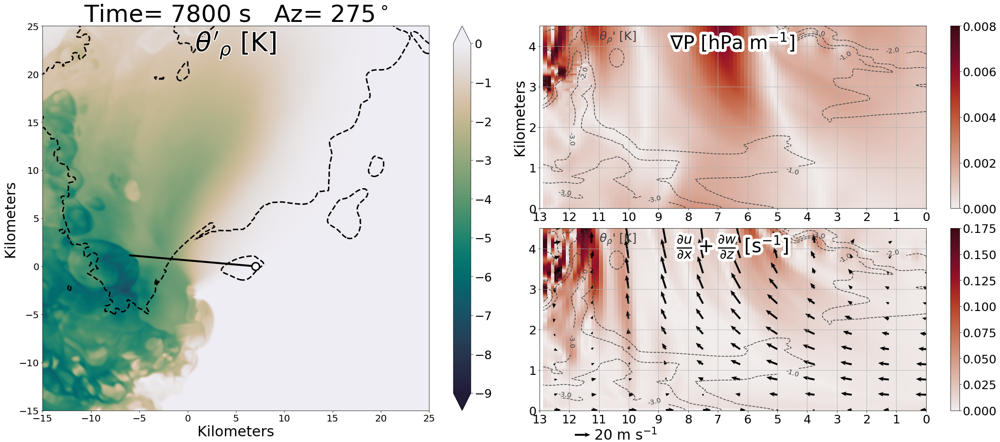

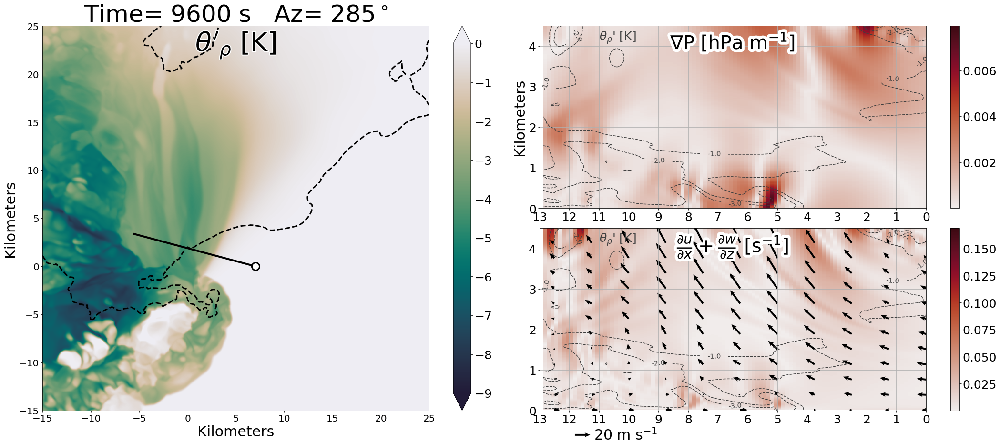

# Error between projected vorticity and velocity inferred vorticity

In [ ]:
import matplotlib
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.colors import LinearSegmentedColormap
from scipy.interpolate import interp1d
from datetime import datetime
from matplotlib.colors import Normalize
import numpy.ma as ma
import matplotlib.colors as colors
from scipy.ndimage import gaussian_filter
import cmocean
import operator
import gc
import xarray as xr
from xarray.backends import NetCDF4DataStore
from scipy.ndimage import map_coordinates
import matplotlib.patheffects as PathEffects
from CM1calc import *
import dask
import dask_image.ndfilters
import dask_image.ndmeasure
import dask.array as da
import pyart

%matplotlib inline

def RHIvort(vel,phi):
    '''
    Function calculates the vorticity on an RHI assuming solid body rotation. Vorticity vector is also assumed normal to plane.
    Calculation: (1/r)*(du_r/dphi), taken from wolfram mathworld on spherical vorticity calculations. 
    Originally was negative, but due to polar coordiantes being reversed in radar world, it is actually positive.
    
    Parameter: radar (pyart object), swp_id (int)
    Returns: vorticity array, same shape as velocity array
    
    For loop iterates through all radii and all slices, the expanded version would look like this:
        
    #radius = 4
    every40 = slice(0, None, 4)
    every41 = slice(1, None, 4)
    every42 = slice(2, None, 4)
    every43 = slice(3, None, 4)
    
    vort4 = np.zeros_like(vel)
    vort4[every40,:] = (1/rangearray[every40,:])*np.gradient(vel[every40,:],phi[every40],axis=0)
    vort4[every41,:] = (1/rangearray[every41,:])*np.gradient(vel[every41,:],phi[every41],axis=0)
    vort4[every42,:] = (1/rangearray[every42,:])*np.gradient(vel[every42,:],phi[every42],axis=0)
    vort4[every43,:] = (1/rangearray[every43,:])*np.gradient(vel[every43,:],phi[every43],axis=0)

    '''
    rangearray=np.linspace(0,RHIlength*1000,bins)
    vort = np.zeros_like(vel)
    vort=(1/rangearray)*np.gradient(vel,np.deg2rad(phi),axis=0) 
    
    return vort

def UHcenter(x,z,w,zvort):
    '''
    Function finds the centroid of the gaussian smoothed 2-5 km UH, if fields are zero, return middle of domain

    Paramters: x (array), z (array), w (array), zvort (array)
    Returns: indices of centroid (y,x)

    Example: x0, y0 = CM1calc.UHcenter(x,z,w,zvort)
    '''

    gausfactor=np.around((1./dx(x))/0.16)
    UH = (w[0,find_nearest(z,2):find_nearest(z,5),:,:]*zvort[0,find_nearest(z,2):find_nearest(z,5),:,:])
    UH=UH.data
    UH = UH.sum(axis=0)
    gauss = dask_image.ndfilters.gaussian_filter(UH,sigma=gausfactor)
    UHfil=gauss>(0.75*np.amax(gauss))

    labelsmaxUH,numlabelsmaxUH=dask_image.ndmeasure.label(UHfil)
    biggest=label_count(labelsmaxUH,numlabelsmaxUH,UHfil)
    mask=np.zeros_like(labelsmaxUH)
    try:
        mask[labelsmaxUH==biggest[0][0]]=1
        centroidsUH=dask_image.ndmeasure.center_of_mass(mask)
    except:
        print('UH not found')
        centroidsUH=(np.shape(UH)[0]/2,np.shape(UH)[0]/2)
    return centroidsUH

radar_levels = [x/10. for x in range(-50,651)]
trlevels = [x / 100. for x in range(-900,1)]

startTime = datetime.now()

x0,y0,z0 = 7., 0., 0. #kilometers from the origin, aka where the radar is located
z0=0.
RHIlength=13. #length of the RHI
bins=1000 #This is the number of points along the line, "bins" if you will, bin length 10-15 m in the Ka
zenithres=0.3 #angle resolution in degrees, this is the correct resolution of the Ka
zenithmax=20.1 #max angle of the RHI

azimuth=175

x1=x0+(RHIlength*np.cos(np.deg2rad(azimuth)))
y1=y0+(RHIlength*np.sin(np.deg2rad(azimuth)))

xbeg=min([x0,x1])
xend=max([x0,x1])
ybeg=min([y0,y1])
yend=max([y0,y1])

fil = 641

print('Beginning to read data in')
filename = '/lustre/research/weiss/schueth/resdep125m/cm1out_000'+str(fil)+'.nc'
ds = xr.open_dataset(filename,chunks={'ni':288,'nj':288})
time = ds['time'].values
x = ds['xh']
y = ds['yh']
z = ds['z']
w = ds['winterp']
zvort = ds['zvort']

centroidsUH = UHcenter(x,z,w,zvort).compute()

x=x-x[centroidsUH[1]]
y=y-y[centroidsUH[0]]
X,Y=np.meshgrid(x.values,y.values)
dxx=dx(x)

xsmall = x.isel(ni=slice(find_nearest(x,xbeg)-2,find_nearest(x,xend)+2))
ysmall = y.isel(nj=slice(find_nearest(y,ybeg)-2,find_nearest(y,yend)+2))

ref =ds['dbz'].isel(time=0,nk=0)
u = ds['uinterp'].isel(time=0)[:,find_nearest(y,ybeg)-2:find_nearest(y,yend)+2,find_nearest(x,xbeg)-2:find_nearest(x,xend)+2]+10.5
v = ds['vinterp'].isel(time=0)[:,find_nearest(y,ybeg)-2:find_nearest(y,yend)+2,find_nearest(x,xbeg)-2:find_nearest(x,xend)+2]+8.7
w = ds['winterp'].isel(time=0)[:,find_nearest(y,ybeg)-2:find_nearest(y,yend)+2,find_nearest(x,xbeg)-2:find_nearest(x,xend)+2]
xvort =ds['xvort'].isel(time=0)[:,find_nearest(y,ybeg)-2:find_nearest(y,yend)+2,find_nearest(x,xbeg)-2:find_nearest(x,xend)+2]
yvort =ds['yvort'].isel(time=0)[:,find_nearest(y,ybeg)-2:find_nearest(y,yend)+2,find_nearest(x,xbeg)-2:find_nearest(x,xend)+2]
zvort =ds['zvort'].isel(time=0)[:,find_nearest(y,ybeg)-2:find_nearest(y,yend)+2,find_nearest(x,xbeg)-2:find_nearest(x,xend)+2]

xvortproj=-np.sin(np.deg2rad(azimuth))*xvort
yvortproj=np.cos(np.deg2rad(azimuth))*yvort

th_corner = ds['th'].isel(time=0,ni=-1,nj=0).values
qr_corner = ds['qr'].isel(time=0,ni=-1,nj=0).values
qi_corner = ds['qi'].isel(time=0,ni=-1,nj=0).values
qc_corner = ds['qc'].isel(time=0,ni=-1,nj=0).values
qs_corner = ds['qs'].isel(time=0,ni=-1,nj=0).values
qg_corner = ds['qg'].isel(time=0,ni=-1,nj=0).values
qv_corner = ds['qv'].isel(time=0,ni=-1,nj=0).values

th_plan = ds['th'].isel(time=0,nk=0)
qr_plan = ds['qr'].isel(time=0,nk=0)
qi_plan = ds['qi'].isel(time=0,nk=0)
qc_plan = ds['qc'].isel(time=0,nk=0)
qs_plan = ds['qs'].isel(time=0,nk=0)
qg_plan = ds['qg'].isel(time=0,nk=0)
qv_plan = ds['qv'].isel(time=0,nk=0)

trhop_plan=perturbation(trho(th_plan,qv_plan,qi_plan,qc_plan,qs_plan,qr_plan,qg_plan),trho(th_corner[0],qv_corner[0],qi_corner[0],qc_corner[0],qs_corner[0],qr_corner[0],qg_corner[0]))

    
#takes care of the special cases of geometry
if azimuth >=0. and azimuth < 90.:
    uproj=u*(1.-np.sin(np.deg2rad(azimuth)))
    vproj=v*(1.-np.cos(np.deg2rad(azimuth)))

if azimuth >= 90. and azimuth < 180.:
    uproj=-u*(1.-np.sin(np.deg2rad(azimuth)))
    vproj=v*(1.-np.cos(np.deg2rad(180-azimuth)))

if azimuth >= 180. and azimuth < 270.:
    uproj=-u*(1.-np.sin(np.deg2rad(360-azimuth)))
    vproj=-v*(1.-np.cos(np.deg2rad(180-azimuth)))

if azimuth >= 270. and azimuth <360.:
    uproj=u*(1.-np.sin(np.deg2rad(360-azimuth)))
    vproj=-v*(1.-np.cos(np.deg2rad(azimuth)))


zenith = np.arange(zenithmax/zenithres+1)*zenithres
xplot = np.zeros((len(zenith),int(bins)))
zplot = np.zeros((len(zenith),int(bins)))
rhiwind=np.zeros((len(zenith),int(bins)))
# rhiwindnew=np.zeros((len(zenith),int(bins)))

rhivortnorm=np.zeros((len(zenith),int(bins)))

for iteration, zen in enumerate(zenith):

    #the distance value of the end of the RHI
    x1=x0+(RHIlength*np.cos(np.deg2rad(azimuth))*np.cos(np.deg2rad(zen)))
    y1=y0+(RHIlength*np.sin(np.deg2rad(azimuth))*np.cos(np.deg2rad(zen)))
    z1=z0+(RHIlength*np.sin(np.deg2rad(zen)))

    #similar to the distance value arrays above, but these are to plot the data
    xplot[iteration,:]=np.linspace(0.,np.sqrt(np.abs(x1-x0)**2+np.abs(y1-y0)**2),bins)
    zplot[iteration,:]=np.linspace(z0,z1,bins)

    #interpolates the distances to the indices
    xinterp=interp1d(xsmall,np.arange(len(xsmall)))
    yinterp=interp1d(ysmall,np.arange(len(ysmall)))
    zinterp=interp1d(z,np.arange(len(z)),bounds_error=False,fill_value=0.0)#takes care of the situation where the lowest level is below the lowest grid point so it can't interpolate

    #find the decimal indices where the rhix values exist, these indices is where the image mapping is going to take place
    rhixi = xinterp(np.linspace(x0,x1,bins))
    rhiyi = yinterp(np.linspace(y0,y1,bins))
    rhizi = zinterp(np.linspace(z0,z1,bins))

    #first input is the full three dimensional data array
    #second input is the indices of the data array where the observations should be
    rhiwind[iteration,:]= map_coordinates(uproj*np.cos(np.deg2rad(zen))+vproj*np.cos(np.deg2rad(zen))-w*np.sin(np.deg2rad(zen)), [rhizi,rhiyi,rhixi]) #adds the projection of the u component on the desired plane and the projection of the v component on the desired plane together
#     rhiwindnew[iteration,:]=map_coordinates(u*np.cos(np.deg2rad(azimuth))*np.sin(np.deg2rad(zen))+v*np.sin(np.deg2rad(azimuth))*np.sin(np.deg2rad(zen))-w*np.cos(np.deg2rad(zen)), [rhizi,rhiyi,rhixi])
    rhivortnorm[iteration,:]= map_coordinates(xvortproj+yvortproj, [rhizi,rhiyi,rhixi])

vort_radvel = RHIvort(rhiwind,zenith)
vort_error = vort_radvel-rhivortnorm

letters=['a)','b)','c)','d)','e)']
c=0

fig = plt.figure(figsize=(45, 13),facecolor='white')

#row,column
ax1 = plt.subplot2grid((2,3),(0,0),rowspan=2)
plan=plt.contourf(X,Y,trhop_plan,trlevels,cmap=cmocean.cm.rain_r,extend='both')
plt.contour(X, Y, ref, [40], colors='black',linewidths=3,linestyles='dashed')
plt.plot([x0,x0+(RHIlength*np.cos(np.deg2rad(azimuth))*np.cos(np.deg2rad(zen)))],[y0,y0+(RHIlength*np.sin(np.deg2rad(azimuth))*np.cos(np.deg2rad(zen)))],color="black",linewidth=4)
plt.plot(x0,y0,'ko', markersize=18)
plt.plot(x0,y0,'wo', markersize=12)
cbar = plt.colorbar(plan, ticks=[-9,-8,-7,-6,-5,-4,-3,-2,-1,0])
cbar.ax.tick_params(labelsize=25)
plt.xlabel('Kilometers', fontsize=30)
plt.ylabel('Kilometers', fontsize=30)
plt.tick_params(axis='both', which='major', labelsize=20)
t1=ax1.text(0.5, 0.99, r"$\theta'_\rho$ [K]", verticalalignment='top', horizontalalignment='center',transform=ax1.transAxes, fontsize=55)
t1.set_path_effects([PathEffects.withStroke(linewidth=4,foreground='white')])
t2=ax1.text(0.025, 0.975, letters[c], verticalalignment='top', horizontalalignment='left',transform=ax1.transAxes, fontsize=75)
t2.set_path_effects([PathEffects.withStroke(linewidth=7,foreground='white')])
c+=1
plt.xlim(-15,25)
plt.ylim(-15,25)
plt.title('Time= '+str(int(time[0]/np.timedelta64(1, 's')))+' s   '+'Az= '+str(int(360-azimuth+90))+r'$^\circ$',fontsize=50)

ax2 = plt.subplot2grid((2,3),(0,1))
ptr = ax2.pcolormesh(xplot,zplot,rhiwind,cmap=cmocean.cm.balance,vmin=-30,vmax=30)
cbar = plt.colorbar(ptr, ticks=[-30,-20,-10,0,10,20,30])
cbar.ax.tick_params(labelsize=25)
ax2.text(0.5, 0.97, "Radial Velocity [m s$^{-1}$]", verticalalignment='top', horizontalalignment='center',transform=ax2.transAxes, fontsize=40)
plt.ylim(0, 4.5)
plt.xlim(13, 0)
plt.ylabel('Kilometers', fontsize=30)
plt.xticks(np.arange(0., 14., 1.0))
plt.yticks(np.arange(0., 5., 1.0))
plt.grid('on')
plt.tick_params(axis='both', which='major', labelsize=25)
t2=ax2.text(0.025, 0.975, letters[c], verticalalignment='top', horizontalalignment='left',transform=ax2.transAxes, fontsize=75)
t2.set_path_effects([PathEffects.withStroke(linewidth=7,foreground='white')])
c+=1

ax3 = plt.subplot2grid((2,3),(0,2))
ptr = ax3.pcolormesh(xplot,zplot,vort_error,cmap="PuOr_r",vmin=-0.075,vmax=0.075)
cbar = plt.colorbar(ptr, ticks=[-0.075,-0.05,-0.025,0,0.025,0.05,0.075])
cbar.ax.tick_params(labelsize=25)
ax3.text(0.45, 0.97, f"Inferred Vorticity \n" "- Projected Vorticity", verticalalignment='top', horizontalalignment='center',transform=ax3.transAxes, fontsize=40)
plt.ylim(0, 4.5)
plt.xlim(13, 0)
plt.ylabel('Kilometers', fontsize=30)
plt.xlabel('Kilometers', fontsize=30)
plt.xticks(np.arange(0., 14., 1.0))
plt.yticks(np.arange(0., 5., 1.0))
plt.grid('on')
plt.tick_params(axis='both', which='major', labelsize=25)
t2=ax3.text(0.025, 0.975, letters[c], verticalalignment='top', horizontalalignment='left',transform=ax3.transAxes, fontsize=75)
t2.set_path_effects([PathEffects.withStroke(linewidth=7,foreground='white')])
c+=1

ax4 = plt.subplot2grid((2,3),(1,1))
pppert=ax4.pcolormesh(xplot,zplot,vort_radvel,cmap="PuOr_r",vmin=-0.075,vmax=0.075)
cbar = plt.colorbar(ptr, ticks=[-0.075,-0.05,-0.025,0,0.025,0.05,0.075])
cbar.ax.tick_params(labelsize=25)
plt.ylim(0, 4.5)
plt.xlim(13, 0)
plt.xticks(np.arange(0., 14., 1.0))
plt.yticks(np.arange(0., 5., 1.0))
plt.grid('on')
plt.tick_params(axis='both', which='major', labelsize=25)
ax4.text(0.5, 0.97, r"Inferred Vorticity [s$^{-1}$]", verticalalignment='top', horizontalalignment='center',transform=ax4.transAxes, fontsize=40)
t2=ax4.text(0.025, 0.975, letters[c], verticalalignment='top', horizontalalignment='left',transform=ax4.transAxes, fontsize=75)
t2.set_path_effects([PathEffects.withStroke(linewidth=7,foreground='white')])
c+=1

ax5 = plt.subplot2grid((2,3),(1,2))
psvort=ax5.pcolormesh(xplot,zplot,rhivortnorm,cmap="PuOr_r",vmin=-0.075,vmax=0.075)
cbar = plt.colorbar(ptr, ticks=[-0.075,-0.05,-0.025,0,0.025,0.05,0.075])
cbar.ax.tick_params(labelsize=25)
ax5.text(0.5, 0.97, r'Projected Vorticity [s$^{-1}$]', verticalalignment='top', horizontalalignment='center',transform=ax5.transAxes, fontsize=40)
plt.ylim(0, 4.5)
plt.xlim(13, 0)
plt.xlabel('Kilometers', fontsize=30)
plt.xticks(np.arange(0., 14., 1.0))
plt.yticks(np.arange(0., 5., 1.0))
plt.grid('on')
plt.tick_params(axis='both', which='major', labelsize=25)
t2=ax5.text(0.025, 0.975, letters[c], verticalalignment='top', horizontalalignment='left',transform=ax5.transAxes, fontsize=75)
t2.set_path_effects([PathEffects.withStroke(linewidth=7,foreground='white')])
c+=1

plt.tight_layout()


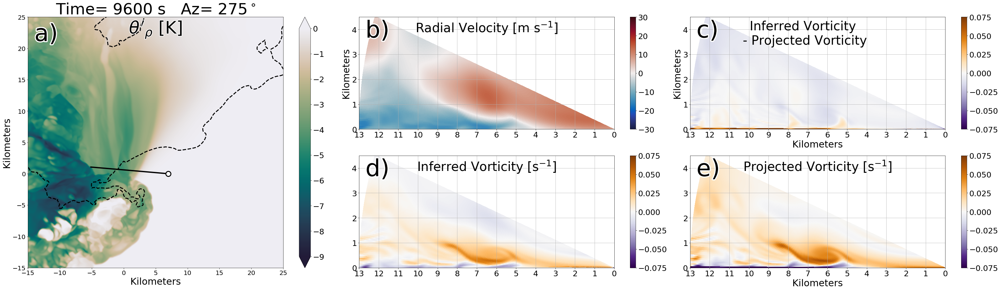

# TLV

In [ ]:
import xarray as xr
from CM1calc import *
import skimage.measure
import matplotlib.pyplot as plt
%matplotlib inline

count10 = np.zeros_like(np.arange(241,682))
count15 = np.zeros_like(np.arange(241,682))
count20 = np.zeros_like(np.arange(241,682))
t = np.zeros_like(count10)
for i,filr in enumerate(range(241, 682)):#[241,281,321,361,401,441,481,521,561,601,641,682]:
    try:
        filename = '/lustre/research/weiss/schueth/resdep125m/cm1out_000'+str(filr)+'.nc'
        ds = xr.open_dataset(filename,chunks={'ni':288,'nj':288})
    except: continue
    
    time = ds['time'].values
    t[i]=int(time[0]/np.timedelta64(1, 's'))

    x = ds['xh']
    y = ds['yh']
    z = ds['z']

    zvort = ds['zvort'].isel(time=0)

    labels05 = skimage.measure.label(zvort[:find_nearest(z,1.02)]>0.05)
    props05 = skimage.measure.regionprops(labels05,zvort[:find_nearest(z,1.02)].values)
    label_num=[]
    intensity=[]
    for p in props05:
        intensity.append(p.max_intensity)
        label_num.append(p.label)
        
    mask05 = np.zeros_like(zvort[:find_nearest(z,1.02)])
    mask05[labels05 == label_num[np.argmax(intensity)]] = 1
    
    zvort05 = np.copy(zvort[:find_nearest(z,1.02),:,:].values)
    zvort05[mask05==0]=0
    
    count10[i] = np.sum(np.sum(zvort05>0.10,axis=(1,2))>0)
    count15[i] = np.sum(np.sum(zvort05>0.15,axis=(1,2))>0)
    count20[i] = np.sum(np.sum(zvort05>0.20,axis=(1,2))>0)

            
fig = plt.figure(figsize=(15, 7),facecolor='white')
plt.bar(t,count10,width=15)
plt.axhline(y=10)
plt.xticks(np.arange(t[0],np.amax(t),60))
plt.yticks(np.arange(0,41,2))
plt.grid()
plt.xlim(t[0],np.amax(t))

fig = plt.figure(figsize=(15, 7),facecolor='white')
plt.bar(t,count15,width=15)
plt.axhline(y=10)
plt.xticks(np.arange(t[0],np.amax(t),60))
plt.yticks(np.arange(0,41,2))
plt.grid()
plt.xlim(t[0],np.amax(t))
           
fig = plt.figure(figsize=(15, 7),facecolor='white')
plt.bar(t,count20,width=15)
plt.axhline(y=10)
plt.xticks(np.arange(t[0],np.amax(t),60))
plt.yticks(np.arange(0,41,2))
plt.grid()
plt.xlim(t[0],np.amax(t))

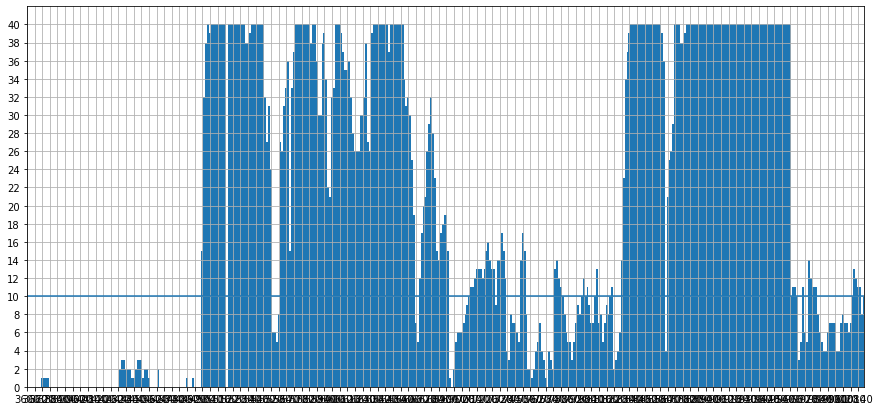

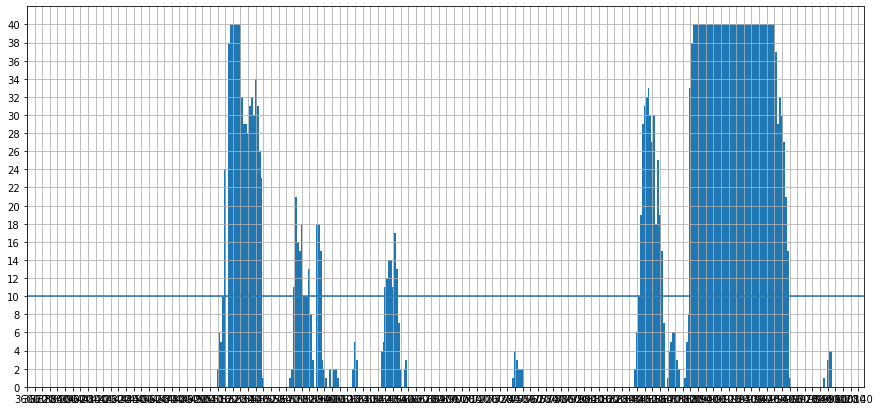

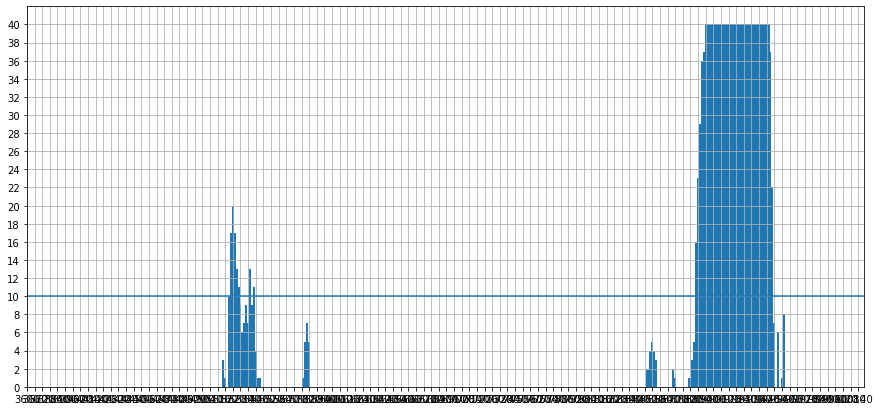

# Additional Parcel Plots

In [ ]:
import matplotlib
import numpy as np
import numpy.ma as ma
from netCDF4 import Dataset
import xarray as xr
from xarray.backends import NetCDF4DataStore
import matplotlib.pyplot as plt
import cmocean
import gc
import os.path
from matplotlib.colors import ListedColormap
from numba import jit
from CM1calc import *
%matplotlib inline
matplotlib.rcParams.update({'font.size': 20})

def find_nearest(array, value):
    array = np.asarray(array)
    idx = (np.abs(array-value)).argmin()
    return idx

path='/lustre/scratch/aschueth/resdep125m/'

print('reading CM1')
filename = '/lustre/research/weiss/schueth/resdep125m/cm1out_000621.nc' #621 or 577-651
refds = xr.open_dataset(filename,chunks={'ni':288,'nj':288})
xref = refds['xh'].values
yref = refds['yh'].values
zref = refds['z'].values
meanref = refds['dbz'].isel(time=0,nk=0).values
meanth = refds['th'].isel(time=0,nk=0).values
meanqr = refds['qr'].isel(time=0,nk=0).values
meanqi = refds['qi'].isel(time=0,nk=0).values
meanqc = refds['qc'].isel(time=0,nk=0).values
meanqs = refds['qs'].isel(time=0,nk=0).values
meanqg = refds['qg'].isel(time=0,nk=0).values
meanqv = refds['qv'].isel(time=0,nk=0).values


trhopert=trhop(meanth,meanqv,meanqi,meanqc,meanqs,meanqr,meanqg,trho(meanth,meanqv,meanqi,meanqc,meanqs,meanqr,meanqg)[0,-1])

print('reading parcels')
#------------------------------------
fils='/lustre/research/weiss/schueth/resdep125m/cm1out_pdata.nc'
dsp = xr.open_dataset(fils)
xpos = dsp['x']
ypos = dsp['y']
zpos = dsp['z']

#currently in format [time:1482, xh:160000]
#need to get it in format [time:1482, x:200,z:600]

u = dsp['u']
v = dsp['v']
w = dsp['w']
xvort = dsp['xi']
yvort = dsp['eta']
zvort = dsp['zeta']

wind = np.sqrt(u**2+v**2+w**2)
vort = np.sqrt(xvort**2+yvort**2+zvort**2)
svort=(u*xvort+v*yvort+w*zvort)/wind
print('Plot1')
#Plot 1

# fig = plt.figure(figsize=(24, 24),facecolor='white')
cmap=cmocean.cm.matter_r

#dummy plot to delete to get the colorbar
Z = [[0,0],[0,0]]
levels = [i/10000. for i in range(0,801,1)]
CS3 = plt.contourf(Z, levels, cmap=cmap)
plt.clf()
#dummy plot to delete to get the colorbar
Z = [[0,0],[0,0]]
trholevels = [x / 100. for x in range(-900, 1, 1)]
CS4 = plt.contourf(Z, trholevels, cmap=cmocean.cm.rain_r)
plt.clf()

print('Plot2')
# Plot 2

fig = plt.figure(figsize=(24, 24),facecolor='white')

#row, column
ax1 = plt.subplot2grid((4,4),(1,0),rowspan=3,colspan=3)
plt.contourf(xref,yref,trhopert,trholevels,cmap=cmocean.cm.rain_r,extend='both')
plt.contour(xref,yref,meanref,[40],colors='black',linewidths=2,linestyles='dashed')
plt.ylim(-5, 20)
plt.xlim(-20, 5)
plt.grid('on')
plt.xlabel('Kilometers', fontsize=30)
plt.ylabel('Kilometers', fontsize=30)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
t1=ax1.text(0.025, 0.975, 'b)', verticalalignment='top', horizontalalignment='left',transform=ax1.transAxes, fontsize=75)
t1.set_path_effects([PathEffects.withStroke(linewidth=7,foreground='white')])
        
ax2 = plt.subplot2grid((4,4),(0,0),colspan=3)
plt.ylim(0,1)
plt.yticks(np.arange(11)/10, fontsize=30)
plt.xticks(fontsize=30)
plt.xlim(-20, 5)
plt.grid('on')
plt.ylabel('Kilometers', fontsize=30)
ax2.set_facecolor('#a5c5cf')
t2=ax2.text(0.025, 0.975, 'a)', verticalalignment='top', horizontalalignment='left',transform=ax2.transAxes, fontsize=75)
t2.set_path_effects([PathEffects.withStroke(linewidth=7,foreground='white')])

ax3 = plt.subplot2grid((4,4),(1,3),rowspan=3)
plt.ylim(-5,20)
plt.xlim(0,1)
plt.yticks(fontsize=30)
plt.xticks(np.arange(6)/5, fontsize=30)
plt.grid('on')
plt.xlabel('Kilometers', fontsize=30)
ax3.set_facecolor('#a5c5cf')
t3=ax3.text(0.75, 0.975, 'c)', verticalalignment='top', horizontalalignment='left',transform=ax3.transAxes, fontsize=75)
t3.set_path_effects([PathEffects.withStroke(linewidth=7,foreground='white')])

parcelid=[15100,15200,15300,15400,15500,15600,15700,15800]

labels=['A2','B2','C2','D2','E2','F2','G2','H2']
for i,pid in enumerate(parcelid):
    col = svort[:2000,pid]/0.08
    xyparcels=ax1.scatter(xpos[:2000,pid]/1000,ypos[:2000,pid]/1000,c='#333333',s=20,linewidths=5)
    xzparcels=ax2.scatter(xpos[:2000,pid]/1000,zpos[:2000,pid]/1000,c='#333333',s=20,linewidths=5)
    yzparcels=ax3.scatter(zpos[:2000,pid]/1000,ypos[:2000,pid]/1000,c='#333333',s=20,linewidths=5)
    
    xyparcels=ax1.scatter(xpos[:2000,pid]/1000,ypos[:2000,pid]/1000,c=cmap(col),s=20,linewidths=0.5)
    xzparcels=ax2.scatter(xpos[:2000,pid]/1000,zpos[:2000,pid]/1000,c=cmap(col),s=20,linewidths=0.5)
    yzparcels=ax3.scatter(zpos[:2000,pid]/1000,ypos[:2000,pid]/1000,c=cmap(col),s=20,linewidths=0.5)
    
    if xpos[0,pid]/1000 > 3.75:
        t2=ax1.text(xpos[find_nearest(xpos[:2000,pid],3750),pid]/1000-0.47,ypos[find_nearest(xpos[:2000,pid],3750),pid]/1000, labels[i], verticalalignment='top', horizontalalignment='left', fontsize=45, fontweight='bold')
        t2.set_path_effects([PathEffects.withStroke(linewidth=7,foreground='white')])
    else:
        t2=ax1.text(xpos[0,pid]/1000,ypos[0,pid]/1000, labels[i], verticalalignment='top', horizontalalignment='left', fontsize=45, fontweight='bold')
        t2.set_path_effects([PathEffects.withStroke(linewidth=7,foreground='white')])

tit=plt.suptitle('Horizontally Seeded Parcel Trajectories',y=0.92, fontsize=50)

cbar_ax = plt.axes([0.925, 0.125, 0.035, 0.775])
cbar=plt.colorbar(CS3, cax=cbar_ax, ticks=[0,0.01,0.02,0.03,0.04,0.05,0.06,0.07,0.08])
cbar.set_label(r'Streamwise Vorticity Magnitude [$s^{-1}$]')

cbar_ax = plt.axes([0.025, 0.125, 0.035, 0.558])
cbar=plt.colorbar(CS4, cax=cbar_ax, ticks=[-9,-8,-7,-6,-5,-4,-3,-2,-1,0])
cbar.set_label('Density Potential Temperature Perturbation [K]', labelpad=-150)
cbar_ax.tick_params(left=True,right=False, labelleft=True, labelright=False)

ax1.set_rasterized(True)
ax2.set_rasterized(True)
ax3.set_rasterized(True)

#test colorbar
fig = plt.figure(figsize=(24, 24),facecolor='white')
cmap=cmocean.cm.matter_r

#dummy plot to delete to get the colorbar
Z = [[0,0],[0,0]]
levels = [i/10000. for i in range(0,801,1)]
CS3 = plt.contourf(Z, levels, cmap=cmap)
plt.clf()
#dummy plot to delete to get the colorbar
Z = [[0,0],[0,0]]
trholevels = [x / 100. for x in range(-900, 1, 1)]
CS4 = plt.contourf(Z, trholevels, cmap=cmocean.cm.rain_r)
plt.clf()

#row, column
ax1 = plt.subplot2grid((4,4),(1,0),rowspan=3,colspan=3)
plt.contourf(xref,yref,trhopert,trholevels,cmap=cmocean.cm.rain_r,extend='both')
plt.contour(xref,yref,meanref,[40],colors='black',linewidths=2,linestyles='dashed')
plt.ylim(-5, 20)
plt.xlim(-20, 5)
plt.grid('on')
plt.xlabel('Kilometers', fontsize=30)
plt.ylabel('Kilometers', fontsize=30)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
t1=ax1.text(0.025, 0.975, 'b)', verticalalignment='top', horizontalalignment='left',transform=ax1.transAxes, fontsize=75)
t1.set_path_effects([PathEffects.withStroke(linewidth=7,foreground='white')])
        
ax2 = plt.subplot2grid((4,4),(0,0),colspan=3)
plt.ylim(0,1)
plt.yticks(np.arange(11)/10, fontsize=30)
plt.xticks(fontsize=30)
plt.xlim(-20, 5)
plt.grid('on')
plt.ylabel('Kilometers', fontsize=30)
ax2.set_facecolor('#a5c5cf')
t2=ax2.text(0.025, 0.975, 'a)', verticalalignment='top', horizontalalignment='left',transform=ax2.transAxes, fontsize=75)
t2.set_path_effects([PathEffects.withStroke(linewidth=7,foreground='white')])

ax3 = plt.subplot2grid((4,4),(1,3),rowspan=3)
plt.ylim(-5,20)
plt.xlim(0,1)
plt.yticks(fontsize=30)
plt.xticks(np.arange(6)/5, fontsize=30)
plt.grid('on')
plt.xlabel('Kilometers', fontsize=30)
ax3.set_facecolor('#a5c5cf')
t3=ax3.text(0.75, 0.975, 'c)', verticalalignment='top', horizontalalignment='left',transform=ax3.transAxes, fontsize=75)
t3.set_path_effects([PathEffects.withStroke(linewidth=7,foreground='white')])

parcelid=[55300,45300,35300,25300,15300,5300]
colors = ['#eeeeee','#bbbbbb','#999999','#666666','#333333','#000000']
labels=['C1','C2','C3','C4','C5','C6']
for i,pid in enumerate(parcelid):
    col = svort[:1850,pid]/0.08
    xyparcels=ax1.scatter(xpos[:1850,pid]/1000,ypos[:1850,pid]/1000,c=colors[i],s=20,linewidths=5)
    xzparcels=ax2.scatter(xpos[:1850,pid]/1000,zpos[:1850,pid]/1000,c=colors[i],s=20,linewidths=5)
    yzparcels=ax3.scatter(zpos[:1850,pid]/1000,ypos[:1850,pid]/1000,c=colors[i],s=20,linewidths=5)
    
    xyparcels=ax1.scatter(xpos[:1850,pid]/1000,ypos[:1850,pid]/1000,c=cmap(col),s=20,linewidths=0.5)
    xzparcels=ax2.scatter(xpos[:1850,pid]/1000,zpos[:1850,pid]/1000,c=cmap(col),s=20,linewidths=0.5)
    yzparcels=ax3.scatter(zpos[:1850,pid]/1000,ypos[:1850,pid]/1000,c=cmap(col),s=20,linewidths=0.5)

    t1=ax1.text(xpos[0,pid]/1000-(0.6*i-0.3*6),ypos[0,pid]/1000+(0.6*i-0.3*6)+0.5, labels[i], verticalalignment='center', horizontalalignment='center', fontsize=30, fontweight='bold',c=colors[5-i])
    t1.set_path_effects([PathEffects.withStroke(linewidth=3,foreground=colors[i])])
  
    t2=ax2.text(xpos[0,pid]/1000+1+1*np.mod(i,2),zpos[0,pid]/1000, labels[5-i], verticalalignment='center', horizontalalignment='center', fontsize=30, fontweight='bold',c=colors[i])
    t2.set_path_effects([PathEffects.withStroke(linewidth=3,foreground=colors[5-i])])

    t3=ax3.text(zpos[0,pid]/1000,ypos[0,pid]/1000+0.6+0.8*np.mod(i,3), labels[5-i], verticalalignment='center', horizontalalignment='center', fontsize=30, fontweight='bold',c=colors[i])
    t3.set_path_effects([PathEffects.withStroke(linewidth=3,foreground=colors[5-i])])
    
tit=plt.suptitle('Vertically Seeded Parcel Trajectories',y=0.92, fontsize=60)

cbar_ax = plt.axes([0.925, 0.125, 0.035, 0.775])
cbar=plt.colorbar(CS3, cax=cbar_ax, ticks=[0,0.01,0.02,0.03,0.04,0.05,0.06,0.07,0.08])
cbar.set_label(r'Streamwise Vorticity Magnitude [$s^{-1}$]')

cbar_ax = plt.axes([0.025, 0.125, 0.035, 0.558])
cbar=plt.colorbar(CS4, cax=cbar_ax, ticks=[-9,-8,-7,-6,-5,-4,-3,-2,-1,0])
cbar.set_label('Density Potential Temperature Perturbation [K]', labelpad=-150)
cbar_ax.tick_params(left=True,right=False, labelleft=True, labelright=False)

ax1.set_rasterized(True)
ax2.set_rasterized(True)
ax3.set_rasterized(True)


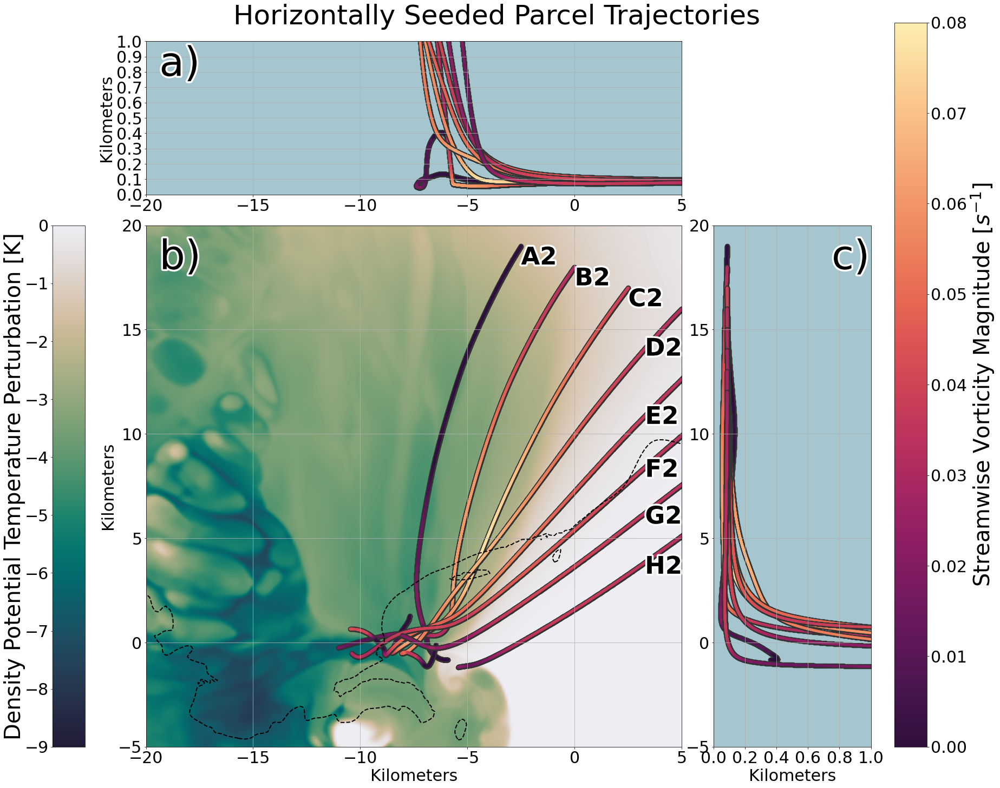

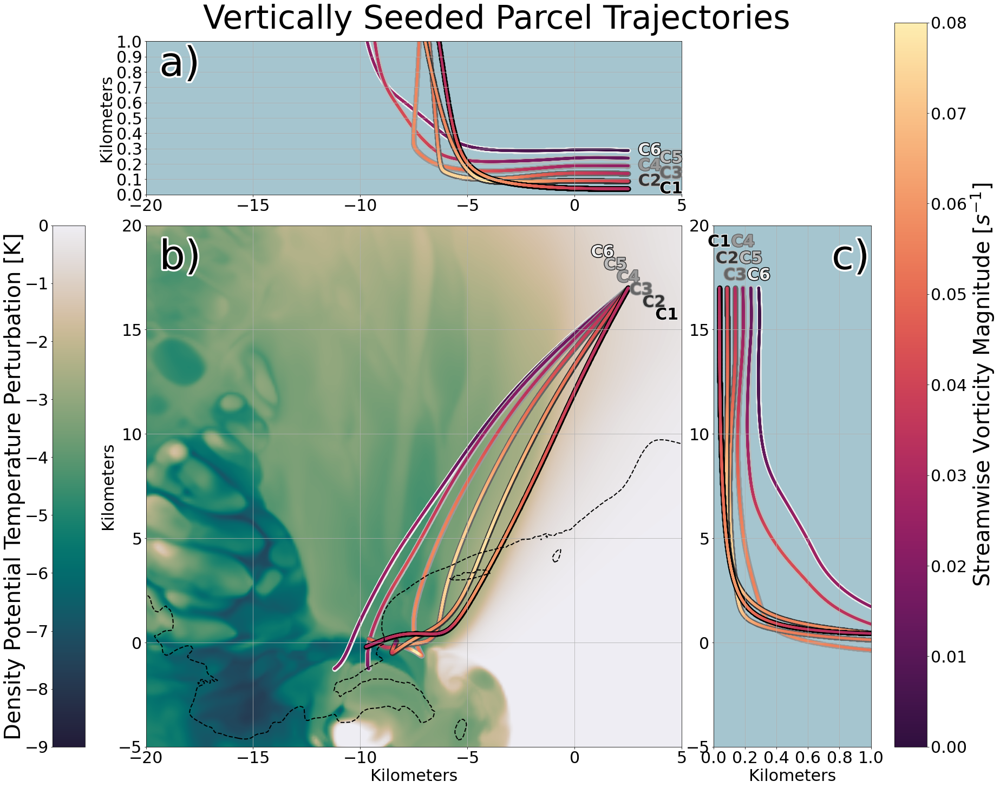

In [ ]:
import matplotlib
# matplotlib.use('agg')
import numpy as np
import numpy.ma as ma
from netCDF4 import Dataset
import xarray as xr
from xarray.backends import NetCDF4DataStore
import matplotlib.pyplot as plt
import cmocean
import gc
import os.path
from matplotlib.colors import ListedColormap
from numba import jit
from CM1calc import *
%matplotlib inline
matplotlib.rcParams.update({'font.size': 20})

def find_nearest(array, value):
    array = np.asarray(array)
    idx = (np.abs(array-value)).argmin()
    return idx

path='/lustre/scratch/aschueth/resdep125m/'
print('reading CM1')
filename = '/lustre/scratch/aschueth/resdep125m/cm1out_000621.nc' #621 or 577-651
refds = xr.open_dataset(filename,chunks={'ni':288,'nj':288})
xref = refds['xh'].values
yref = refds['yh'].values
zref = refds['z'].values
meanref = refds['dbz'].isel(time=0,nk=0).values
meanth = refds['th'].isel(time=0,nk=0).values
meanqr = refds['qr'].isel(time=0,nk=0).values
meanqi = refds['qi'].isel(time=0,nk=0).values
meanqc = refds['qc'].isel(time=0,nk=0).values
meanqs = refds['qs'].isel(time=0,nk=0).values
meanqg = refds['qg'].isel(time=0,nk=0).values
meanqv = refds['qv'].isel(time=0,nk=0).values


trhopert=trhop(meanth,meanqv,meanqi,meanqc,meanqs,meanqr,meanqg,trho(meanth,meanqv,meanqi,meanqc,meanqs,meanqr,meanqg)[0,-1])

# meanref = ref.mean(dim='time').values
print('reading parcels')
#------------------------------------
fils='/lustre/scratch/aschueth/new/cm1out_pdata.nc'
dsp = xr.open_dataset(fils)

fig = plt.figure(figsize=(24, 24),facecolor='white')
cmap=cmocean.cm.matter_r

#dummy plot to delete to get the colorbar
Z = [[0,0],[0,0]]
levels = [i/10000. for i in range(0,801,1)]
CS3 = plt.contourf(Z, levels, cmap=cmap)
plt.clf()
#dummy plot to delete to get the colorbar
Z = [[0,0],[0,0]]
trholevels = [x / 100. for x in range(-900, 1, 1)]
CS4 = plt.contourf(Z, trholevels, cmap=cmocean.cm.haline)
plt.clf()

#row, column
ax1 = plt.subplot2grid((4,4),(1,0),rowspan=3,colspan=3)
plt.contourf(xref,yref,trhopert,trholevels,cmap=cmocean.cm.haline,extend='both')
plt.contour(xref,yref,meanref,[40],colors='black',linewidths=2,linestyles='dashed')
plt.ylim(-5, 20)
plt.xlim(-20, 5)
plt.grid('on')
plt.xlabel('Kilometers')
plt.ylabel('Kilometers')

ax2 = plt.subplot2grid((4,4),(0,0),colspan=3)
plt.ylim(0,1)
plt.yticks(np.arange(11)/10)
plt.xlim(-20, 5)
plt.grid('on')
plt.ylabel('Kilometers')
ax2.set_facecolor('#a5c5cf')

ax3 = plt.subplot2grid((4,4),(1,3),rowspan=3)
plt.ylim(-5,20)
plt.xlim(0,1)
plt.xticks(np.arange(11)/10)
plt.grid('on')
plt.xlabel('Kilometers')
ax3.set_facecolor('#a5c5cf')


for parcelid in [15300,15200,15500]:
    xpos = dsp.x[:,parcelid].values
    ypos = dsp.y[:,parcelid].values
    zpos = dsp.z[:,parcelid].values

    xi = dsp.xi[:,parcelid].values
    eta = dsp.eta[:,parcelid].values
    zeta = dsp.zeta[:,parcelid].values

    u = dsp.u[:,parcelid].values
    v = dsp.v[:,parcelid].values
    w = dsp.w[:,parcelid].values

    dudx = dsp.dudx[:,parcelid].values
    dudy = dsp.dudy[:,parcelid].values
    dudz = dsp.dudz[:,parcelid].values

    dvdx = dsp.dvdx[:,parcelid].values
    dvdy = dsp.dvdy[:,parcelid].values
    dvdz = dsp.dvdz[:,parcelid].values

    dwdx = dsp.dwdx[:,parcelid].values
    dwdy = dsp.dwdy[:,parcelid].values
    dwdz = dsp.dwdz[:,parcelid].values

    windh = np.sqrt(u**2+v**2)
    omegah = np.sqrt(xi**2+eta**2)
    somegah = (u*xi+v*eta)/windh

    xiten_sgs = dsp.xiten_sgs[:,parcelid].values
    xiten_idiff = dsp.xiten_idiff[:,parcelid].values
    xiten_ediff = dsp.xiten_ediff[:,parcelid].values
    xiten_pgf = dsp.xiten_pgf[:,parcelid].values
    xiten_cor = dsp.xiten_cor[:,parcelid].values
    xiten_tilt    = zeta * dudz + eta * dudy
    xiten_stretch = -xi * (dvdy+dwdz)

    etaten_sgs = dsp.etaten_sgs[:,parcelid].values
    etaten_idiff = dsp.etaten_idiff[:,parcelid].values
    etaten_ediff = dsp.etaten_ediff[:,parcelid].values
    etaten_pgf = dsp.etaten_pgf[:,parcelid].values
    etaten_cor = dsp.etaten_cor[:,parcelid].values
    etaten_tilt    = xi * dvdx + zeta * dvdz
    etaten_stretch = -eta * (dudx+dwdz)
    
    col = somegah[:1850]/0.08
    xyparcels=ax1.scatter(xpos[:1850]/1000,ypos[:1850]/1000,c='#333333',s=20,linewidths=5)
    xzparcels=ax2.scatter(xpos[:1850]/1000,zpos[:1850]/1000,c='#333333',s=20,linewidths=5)
    yzparcels=ax3.scatter(zpos[:1850]/1000,ypos[:1850]/1000,c='#333333',s=20,linewidths=5)

    xyparcels=ax1.scatter(xpos[:1850]/1000,ypos[:1850]/1000,c=cmap(col),s=20,linewidths=0.5)
    xzparcels=ax2.scatter(xpos[:1850]/1000,zpos[:1850]/1000,c=cmap(col),s=20,linewidths=0.5)
    yzparcels=ax3.scatter(zpos[:1850]/1000,ypos[:1850]/1000,c=cmap(col),s=20,linewidths=0.5)

    ax2.plot(xpos[100:1550][::250]/1000,zpos[100:1550][::250]/1000,'ko')
    ax3.plot(zpos[100:1550][::250]/1000,ypos[100:1550][::250]/1000,'ko')
    ax1.quiver(xpos[100:1550][::250]/1000,ypos[100:1550][::250]/1000,xi[100:1550][::250],eta[100:1550][::250],color='k',label='vorticity',scale=1)
    ax1.quiver(xpos[100:1550][::250]/1000,ypos[100:1550][::250]/1000,xiten_stretch[100:1550][::250],etaten_stretch[100:1550][::250],color='#1f77b4',label='stretch',scale=0.0005)
    ax1.quiver(xpos[100:1550][::250]/1000,ypos[100:1550][::250]/1000,xiten_tilt[100:1550][::250],etaten_tilt[100:1550][::250],color='#ff7f0e',label='tilt',scale=0.0005)
    ax1.quiver(xpos[100:1550][::250]/1000,ypos[100:1550][::250]/1000,xiten_sgs[100:1550][::250],etaten_sgs[100:1550][::250],color='#2ca02c',label='sgs',scale=0.0005)
    ax1.quiver(xpos[100:1550][::250]/1000,ypos[100:1550][::250]/1000,xiten_pgf[100:1550][::250],etaten_pgf[100:1550][::250],color='#d62728',label='baroclinic',scale=0.0005)

ax1.legend(loc='lower left')

tit=fig.suptitle('Parcel Trajectories', fontsize=50)

cbar_ax = plt.axes([0.925, 0.125, 0.035, 0.775])
cbar=plt.colorbar(CS3, cax=cbar_ax, ticks=[0,0.01,0.02,0.03,0.04,0.05,0.06,0.07,0.08])
cbar.set_label('Streamwise Vorticity Magnitude')

cbar_ax = plt.axes([0.025, 0.125, 0.035, 0.558])
cbar=plt.colorbar(CS4, cax=cbar_ax, ticks=[-9,-8,-7,-6,-5,-4,-3,-2,-1,0])
cbar.set_label('Theta Rho Perturbation', labelpad=-130)
cbar_ax.tick_params(left=True,right=False, labelleft=True, labelright=False)

ax1.set_rasterized(True)
ax2.set_rasterized(True)
ax3.set_rasterized(True)

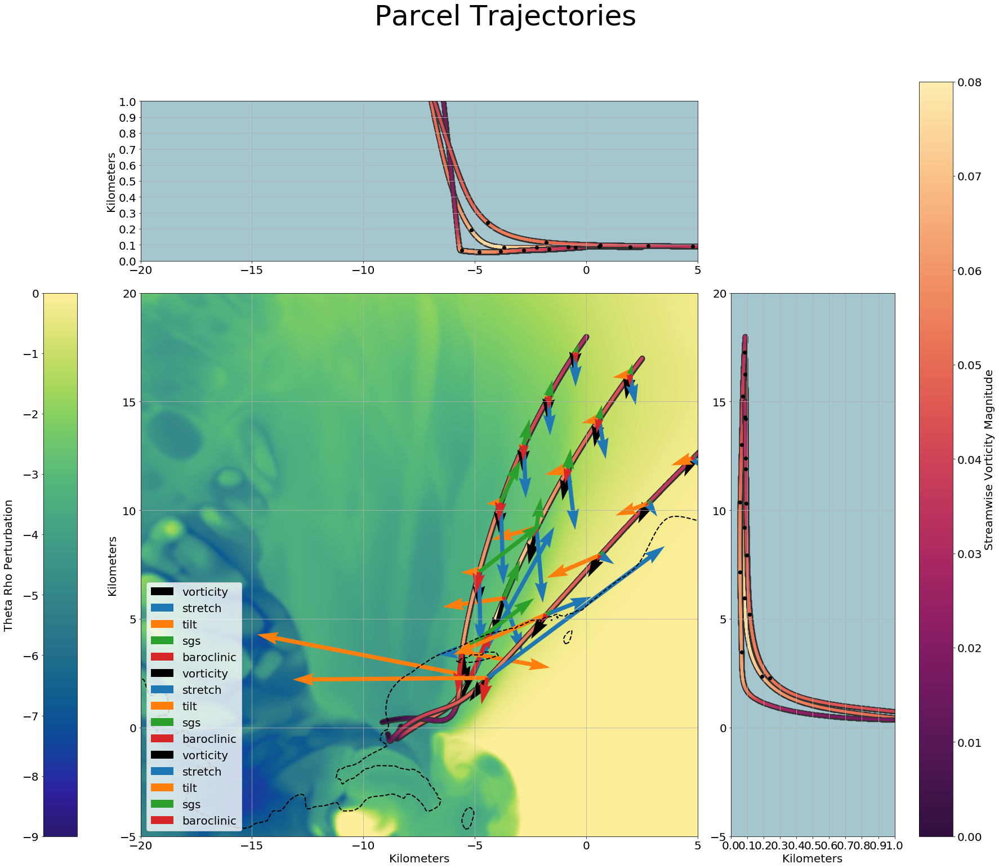